In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
from pylab import rcParams
import warnings
from sklearn.preprocessing import StandardScaler
from math import pi
import seaborn as sns 
rcParams["figure.figsize"]=(30,18)
plt.rcParams['figure.dpi'] = 300
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = 15
warnings.filterwarnings("ignore")
warnings.simplefilter(action='ignore', category=FutureWarning)
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/heart-attack-prediction-dataset/heart_attack_prediction_dataset.csv


In [2]:
df=pd.read_csv('/kaggle/input/heart-attack-prediction-dataset/heart_attack_prediction_dataset.csv')
df

,Patient ID,Age,Sex,Cholesterol,Blood Pressure,Heart Rate,Diabetes,Family History,Smoking,Obesity,...,Sedentary Hours Per Day,Income,BMI,Triglycerides,Physical Activity Days Per Week,Sleep Hours Per Day,Country,Continent,Hemisphere,Heart Attack Risk
0,BMW7812,67,Male,208,158/88,72,0,0,1,0,...,6.615001,261404,31.251233,286,0,6,Argentina,South America,Southern Hemisphere,0
1,CZE1114,21,Male,389,165/93,98,1,1,1,1,...,4.963459,285768,27.194973,235,1,7,Canada,North America,Northern Hemisphere,0
2,BNI9906,21,Female,324,174/99,72,1,0,0,0,...,9.463426,235282,28.176571,587,4,4,France,Europe,Northern Hemisphere,0
3,JLN3497,84,Male,383,163/100,73,1,1,1,0,...,7.648981,125640,36.464704,378,3,4,Canada,North America,Northern Hemisphere,0
4,GFO8847,66,Male,318,91/88,93,1,1,1,1,...,1.514821,160555,21.809144,231,1,5,Thailand,Asia,Northern Hemisphere,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8758,MSV9918,60,Male,121,94/76,61,1,1,1,0,...,10.806373,235420,19.655895,67,7,7,Thailand,Asia,Northern Hemisphere,0
8759,QSV6764,28,Female,120,157/102,73,1,0,0,1,...,3.833038,217881,23.993866,617,4,9,Canada,North America,Northern Hemisphere,0
8760,XKA5925,47,Male,250,161/75,105,0,1,1,1,...,2.375214,36998,35.406146,527,4,4,Brazil,South America,Southern Hemisphere,1
8761,EPE6801,36,Male,178,119/67,60,1,0,1,0,...,0.029104,209943,27.294020,114,2,8,Brazil,South America,Southern Hemisphere,0


In [3]:
df.isnull().sum()

Patient ID                         0
Age                                0
Sex                                0
Cholesterol                        0
Blood Pressure                     0
Heart Rate                         0
Diabetes                           0
Family History                     0
Smoking                            0
Obesity                            0
Alcohol Consumption                0
Exercise Hours Per Week            0
Diet                               0
Previous Heart Problems            0
Medication Use                     0
Stress Level                       0
Sedentary Hours Per Day            0
Income                             0
BMI                                0
Triglycerides                      0
Physical Activity Days Per Week    0
Sleep Hours Per Day                0
Country                            0
Continent                          0
Hemisphere                         0
Heart Attack Risk                  0
dtype: int64

In [4]:
df.columns

Index(['Patient ID', 'Age', 'Sex', 'Cholesterol', 'Blood Pressure',
       'Heart Rate', 'Diabetes', 'Family History', 'Smoking', 'Obesity',
       'Alcohol Consumption', 'Exercise Hours Per Week', 'Diet',
       'Previous Heart Problems', 'Medication Use', 'Stress Level',
       'Sedentary Hours Per Day', 'Income', 'BMI', 'Triglycerides',
       'Physical Activity Days Per Week', 'Sleep Hours Per Day', 'Country',
       'Continent', 'Hemisphere', 'Heart Attack Risk'],
      dtype='object')

In [5]:
sns.set(style="whitegrid", palette="pastel", font_scale=1.2)
plt.rcParams['figure.figsize'] = (10, 6)

In [6]:
# Extract Systolic and Diastolic BP
df[['Systolic_BP', 'Diastolic_BP']] = df['Blood Pressure'].str.split('/', expand=True).astype(int)

# Create new features
df['Is_Senior'] = df['Age'] >= 60
df['BMI_Category'] = pd.cut(df['BMI'], bins=[0, 18.5, 25, 30, np.inf], labels=["Underweight", "Normal", "Overweight", "Obese"])
df['Risk_Score'] = (
    df['Age']*0.2 +
    df['Cholesterol']*0.1 +
    df['Heart Rate']*0.05 +
    df['Stress Level']*0.1 +
    df['Smoking']*10 +
    df['Obesity']*10 +
    df['Diabetes']*15
)


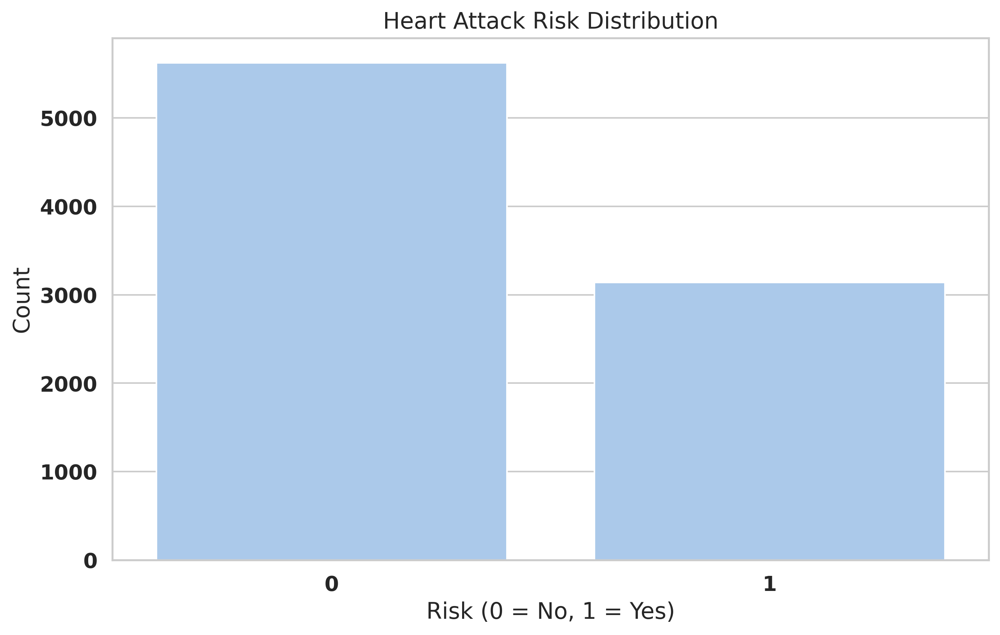

In [7]:
sns.countplot(x='Heart Attack Risk', data=df)
plt.title("Heart Attack Risk Distribution")
plt.xlabel("Risk (0 = No, 1 = Yes)")
plt.ylabel("Count")
plt.show()


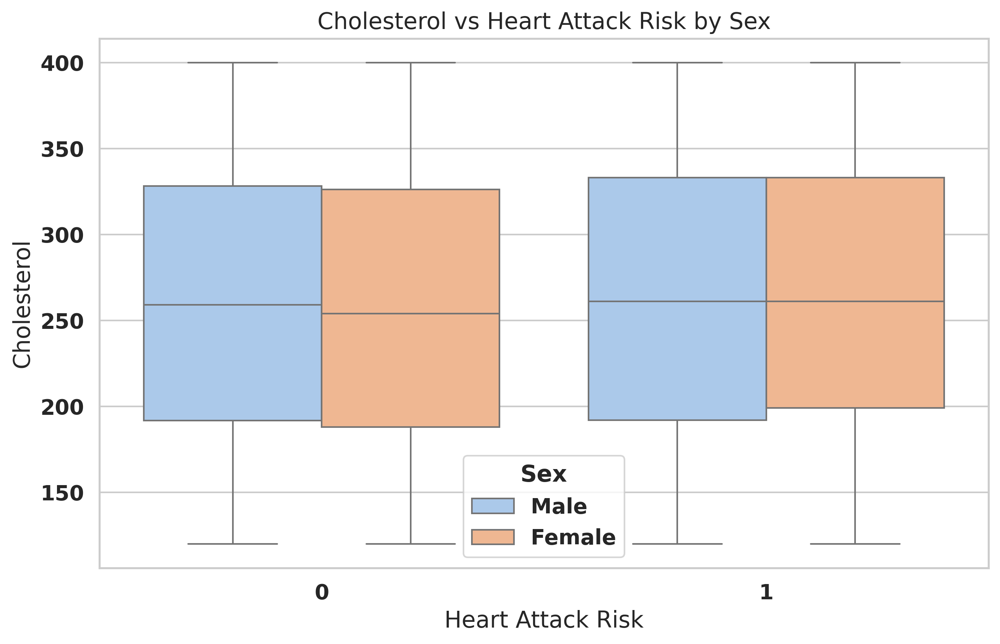

In [8]:
sns.boxplot(x='Heart Attack Risk', y='Cholesterol', data=df, hue='Sex')
plt.title("Cholesterol vs Heart Attack Risk by Sex")
plt.show()


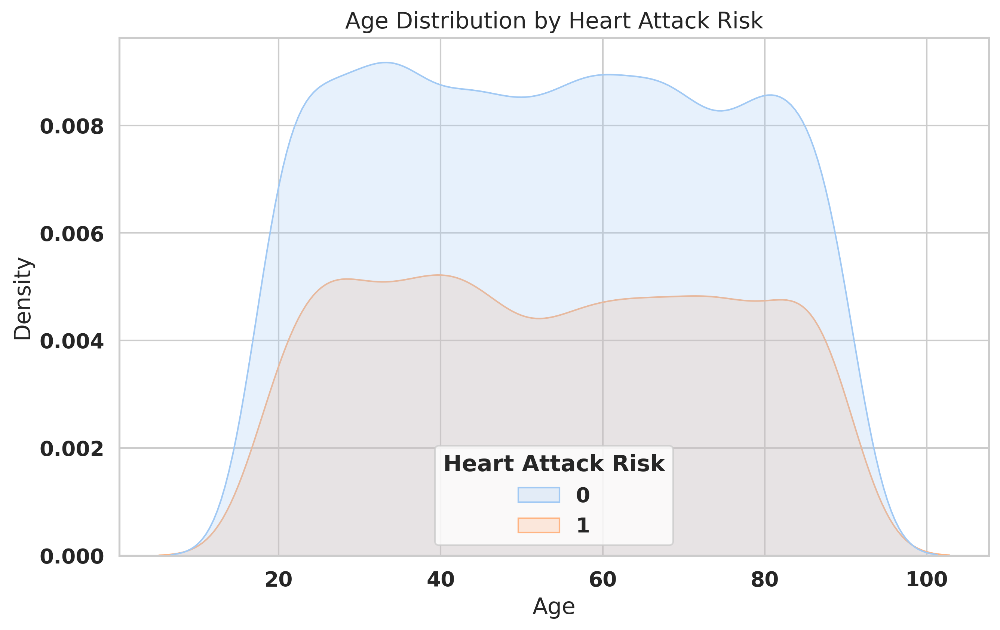

In [9]:
sns.kdeplot(data=df, x='Age', hue='Heart Attack Risk', fill=True)
plt.title("Age Distribution by Heart Attack Risk")
plt.show()


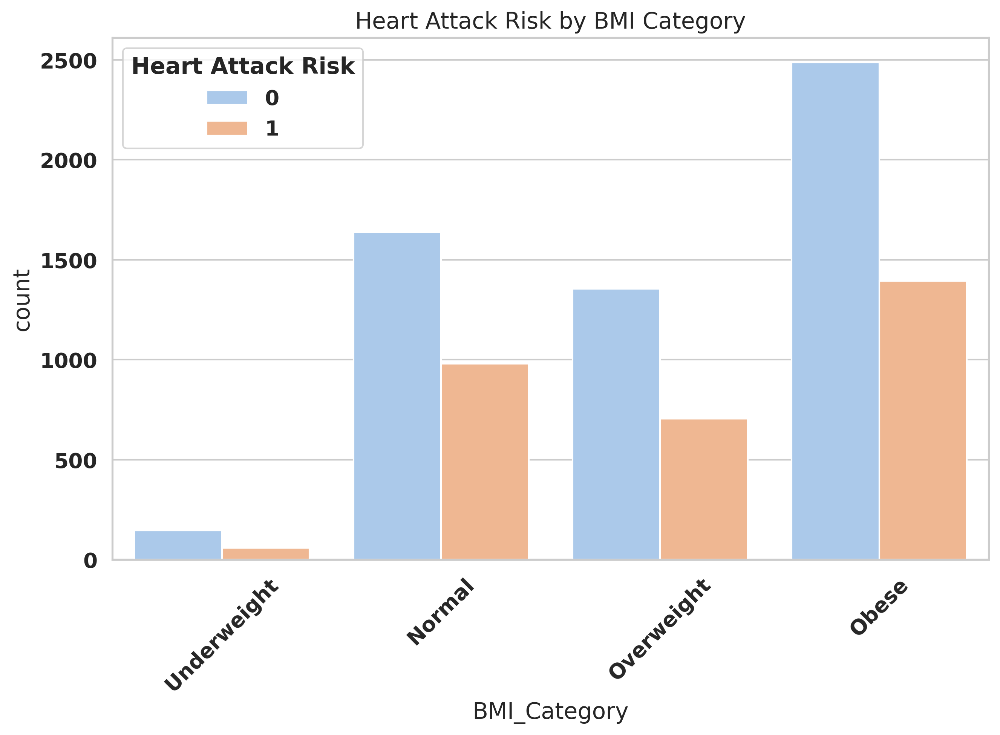

In [10]:
sns.countplot(x='BMI_Category', hue='Heart Attack Risk', data=df)
plt.title("Heart Attack Risk by BMI Category")
plt.xticks(rotation=45)
plt.show()


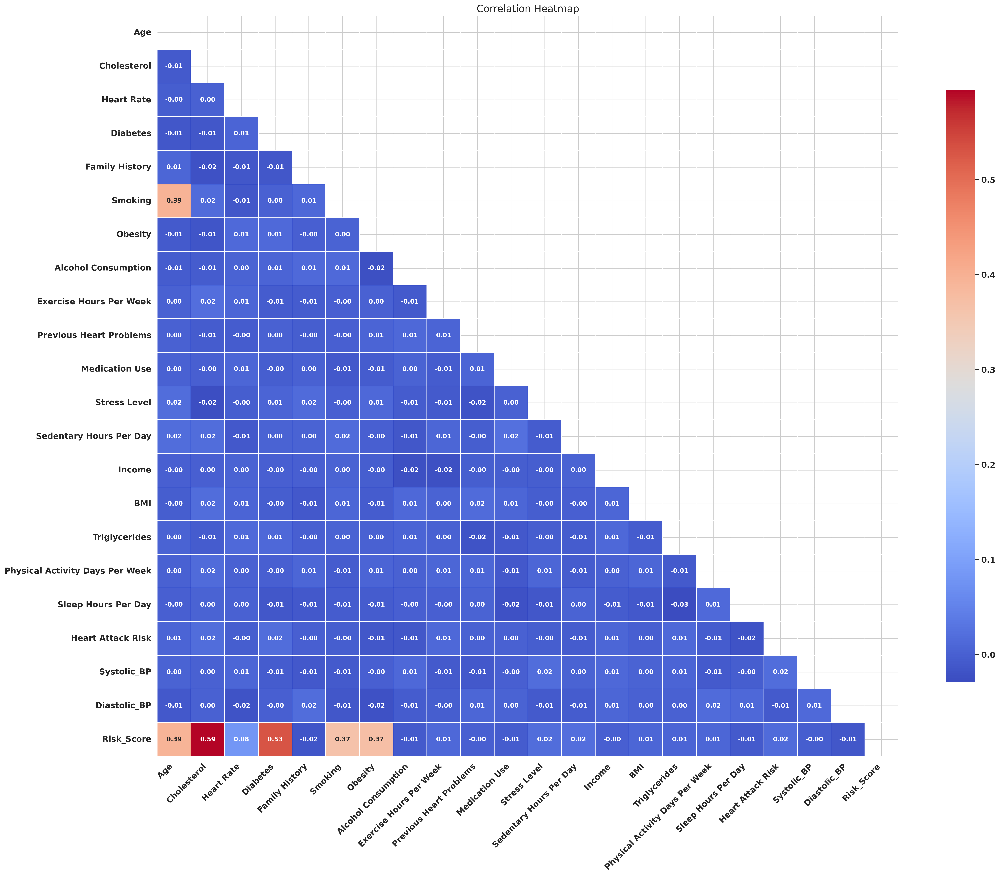

In [15]:
numerics = df.select_dtypes(include=np.number)

# Compute the correlation matrix
corr = numerics.corr()

# Set up the matplotlib figure
plt.figure(figsize=(25, 20))

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Draw the heatmap
sns.heatmap(
    corr, 
    mask=mask, 
    annot=True, 
    fmt=".2f", 
    cmap='coolwarm', 
    square=True, 
    linewidths=0.5, 
    cbar_kws={"shrink": 0.8}, 
    annot_kws={"size": 10}
)

plt.title("Correlation Heatmap", fontsize=16)
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

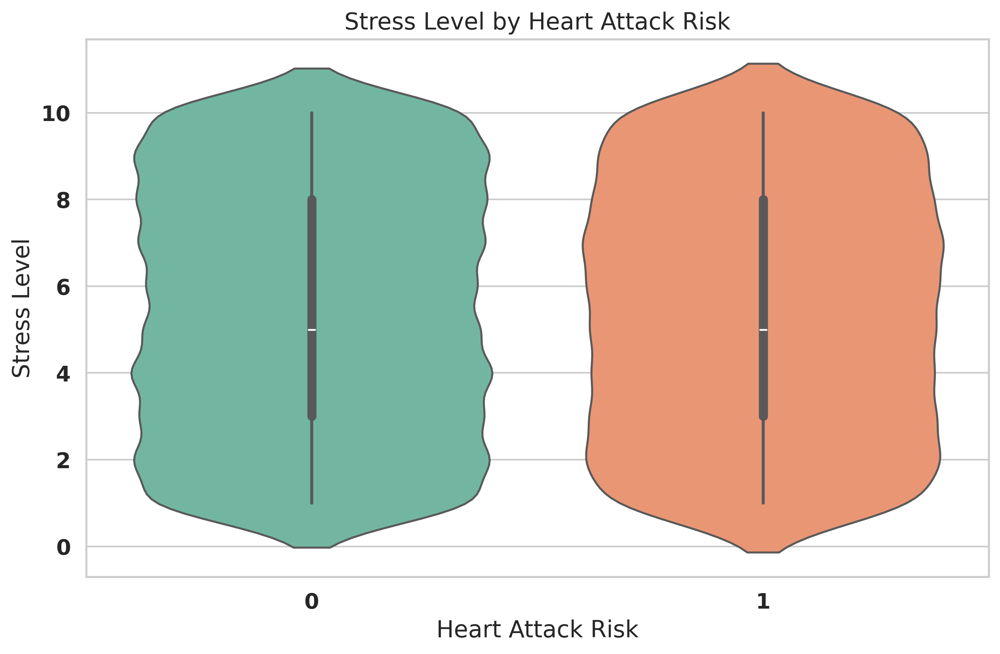

In [12]:
sns.violinplot(x='Heart Attack Risk', y='Stress Level', data=df, inner='box', palette="Set2")
plt.title("Stress Level by Heart Attack Risk")
plt.show()


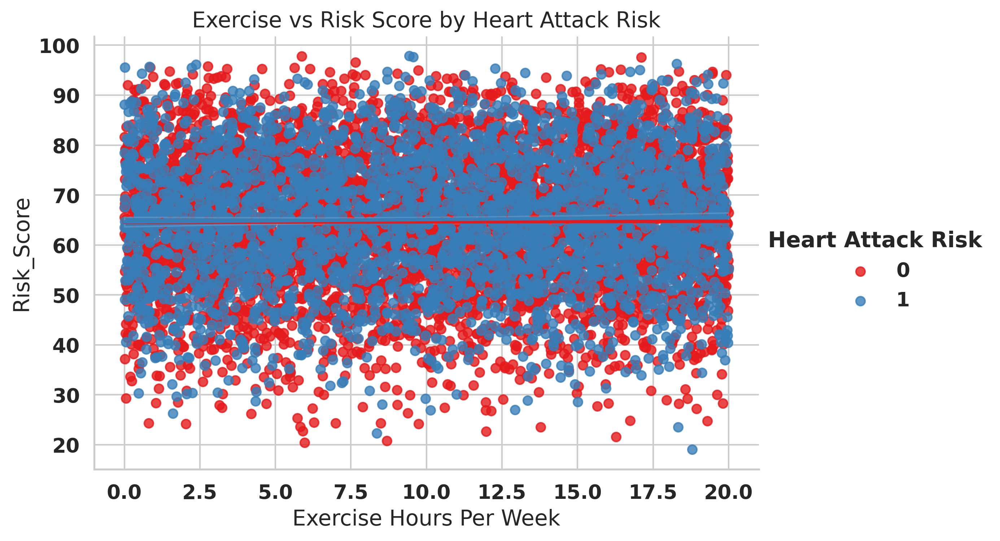

In [16]:
sns.lmplot(x='Exercise Hours Per Week', y='Risk_Score', hue='Heart Attack Risk', data=df,
           palette='Set1', aspect=1.5, height=5)
plt.title("Exercise vs Risk Score by Heart Attack Risk")
plt.show()


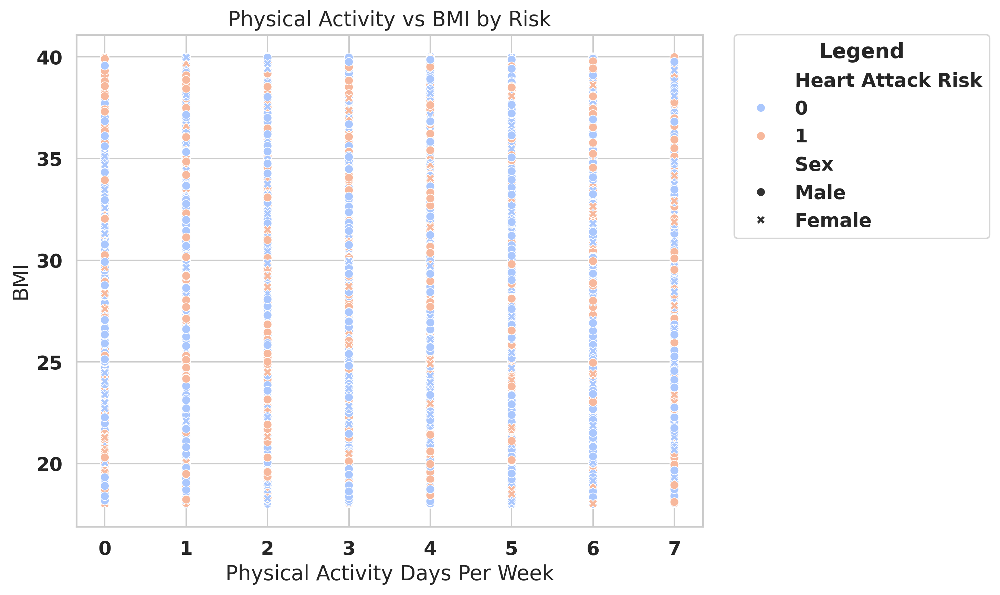

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))

sns.scatterplot(
    data=df,
    x='Physical Activity Days Per Week',
    y='BMI',
    hue='Heart Attack Risk',
    style='Sex',
    palette='coolwarm'
)

plt.title("Physical Activity vs BMI by Risk")

# Move legend outside the plot
plt.legend(
    bbox_to_anchor=(1.05, 1),  # X and Y offset
    loc='upper left',          # Anchor point of the legend
    borderaxespad=0,
    title="Legend"
)

plt.tight_layout()
plt.show()


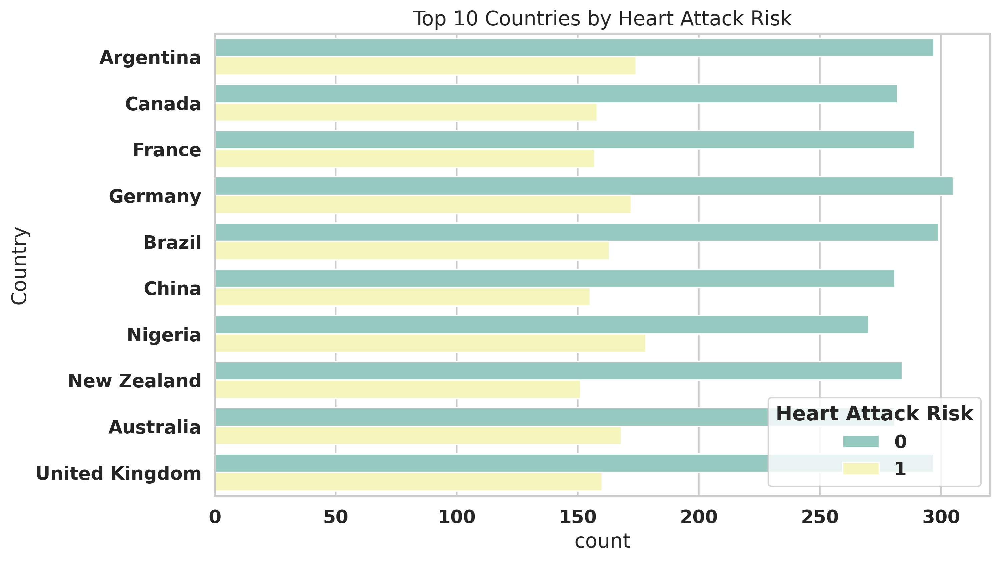

In [18]:
top_countries = df['Country'].value_counts().head(10).index
sns.countplot(data=df[df['Country'].isin(top_countries)], y='Country', hue='Heart Attack Risk', palette='Set3')
plt.title("Top 10 Countries by Heart Attack Risk")
plt.show()



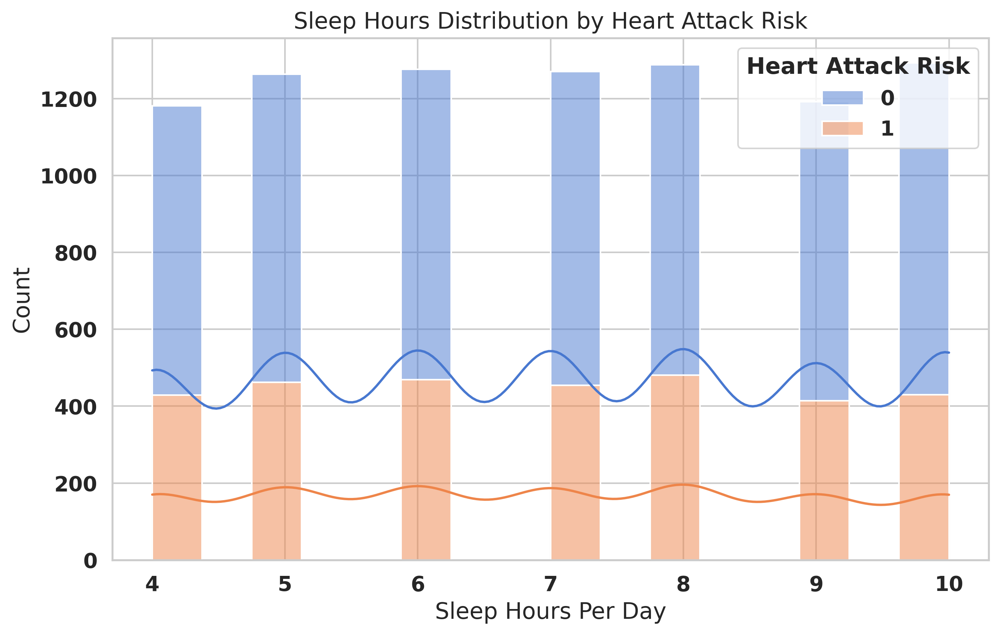

In [20]:
sns.histplot(data=df, x='Sleep Hours Per Day', hue='Heart Attack Risk', kde=True, multiple="stack", palette='muted')
plt.title("Sleep Hours Distribution by Heart Attack Risk")
plt.show()


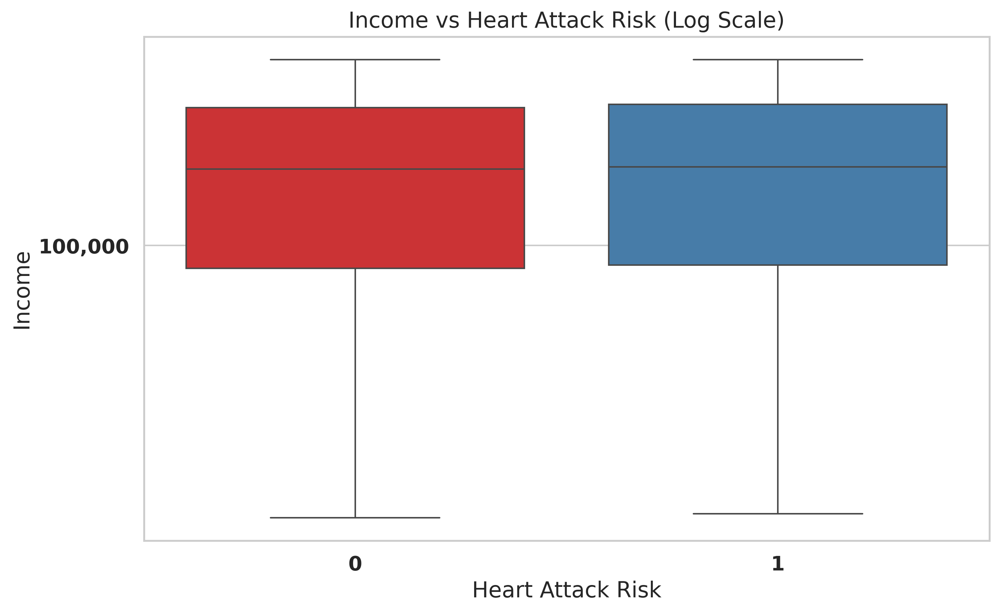

In [21]:
import matplotlib.ticker as ticker

sns.boxplot(x='Heart Attack Risk', y='Income', data=df, palette='Set1')
plt.yscale('log')
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x):,}'))
plt.title("Income vs Heart Attack Risk (Log Scale)")
plt.show()


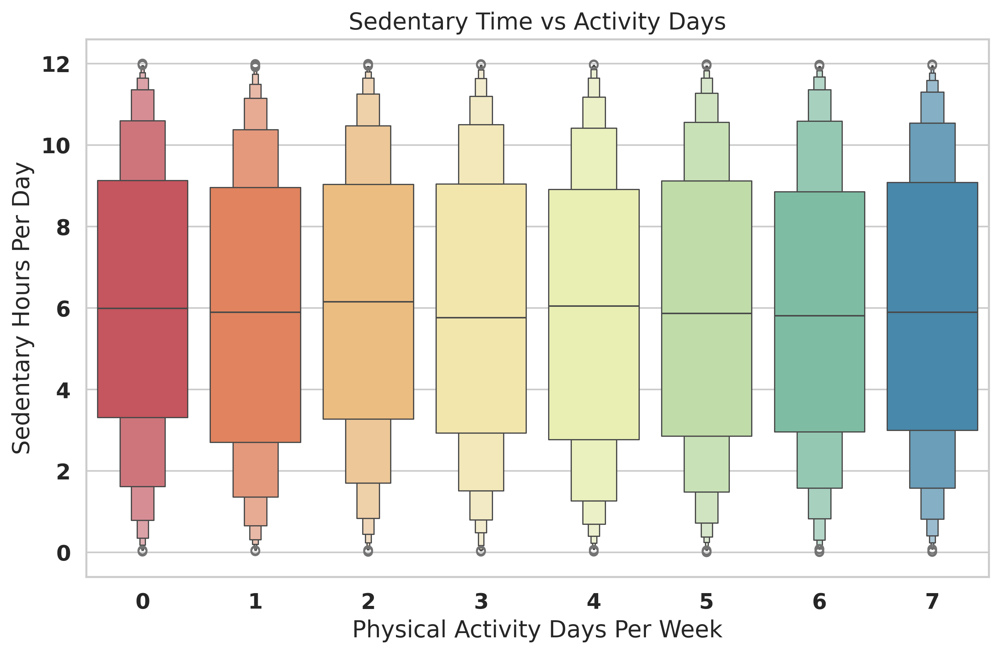

In [22]:
sns.boxenplot(data=df, x='Physical Activity Days Per Week', y='Sedentary Hours Per Day', palette="Spectral")
plt.title("Sedentary Time vs Activity Days")
plt.show()


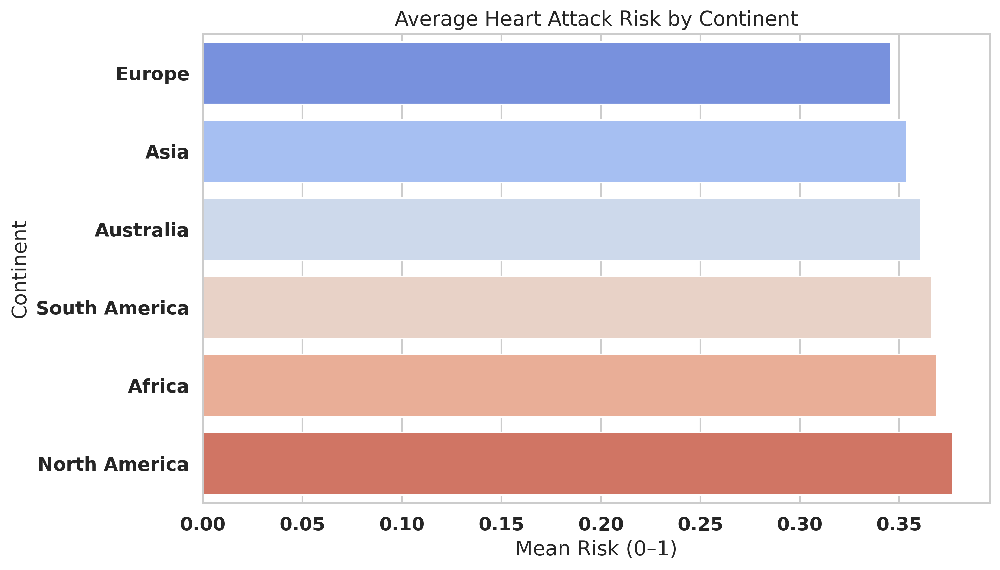

In [23]:
continent_risk = df.groupby('Continent')['Heart Attack Risk'].mean().sort_values()
sns.barplot(x=continent_risk.values, y=continent_risk.index, palette='coolwarm')
plt.title("Average Heart Attack Risk by Continent")
plt.xlabel("Mean Risk (0–1)")
plt.show()


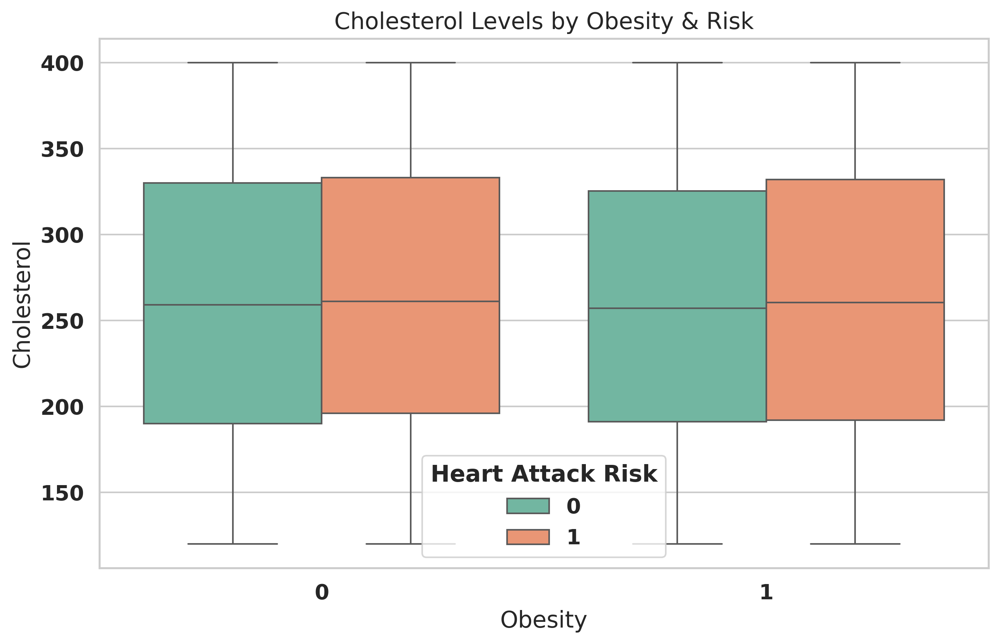

In [24]:
sns.boxplot(data=df, x='Obesity', y='Cholesterol', hue='Heart Attack Risk', palette='Set2')
plt.title("Cholesterol Levels by Obesity & Risk")
plt.show()


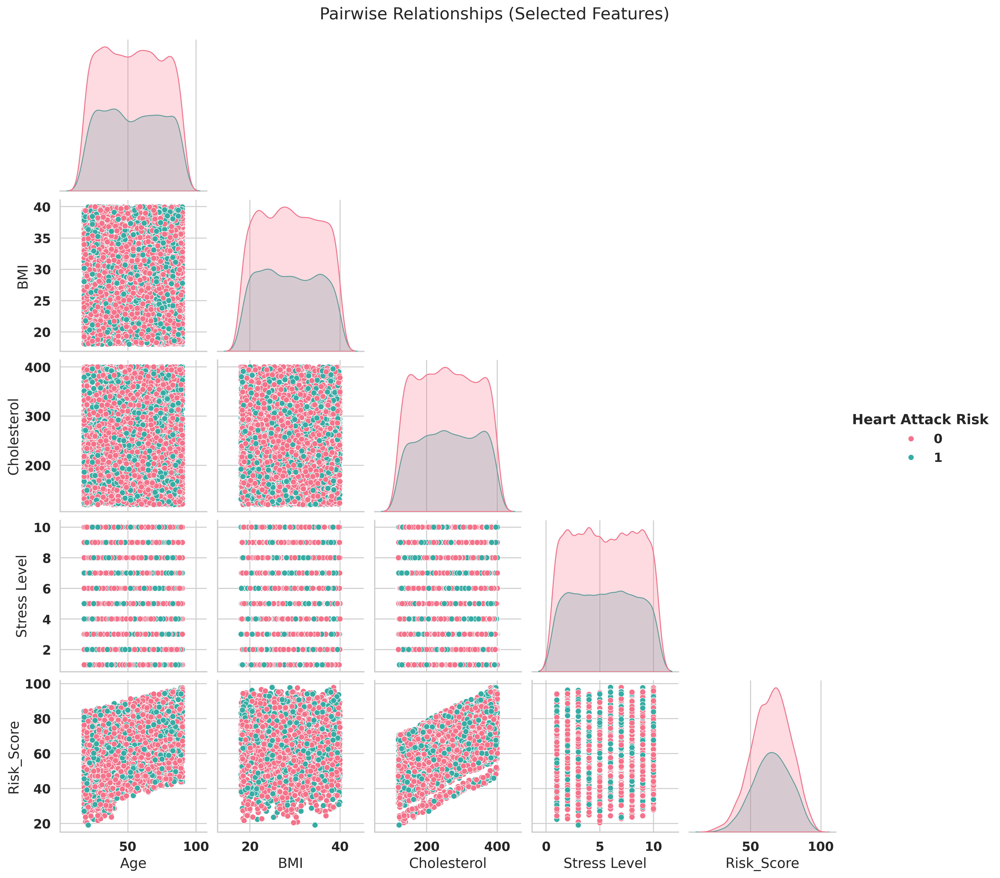

In [25]:
selected = ['Age', 'BMI', 'Cholesterol', 'Stress Level', 'Risk_Score', 'Heart Attack Risk']
sns.pairplot(df[selected], hue='Heart Attack Risk', palette='husl', corner=True)
plt.suptitle("Pairwise Relationships (Selected Features)", y=1.02)
plt.show()


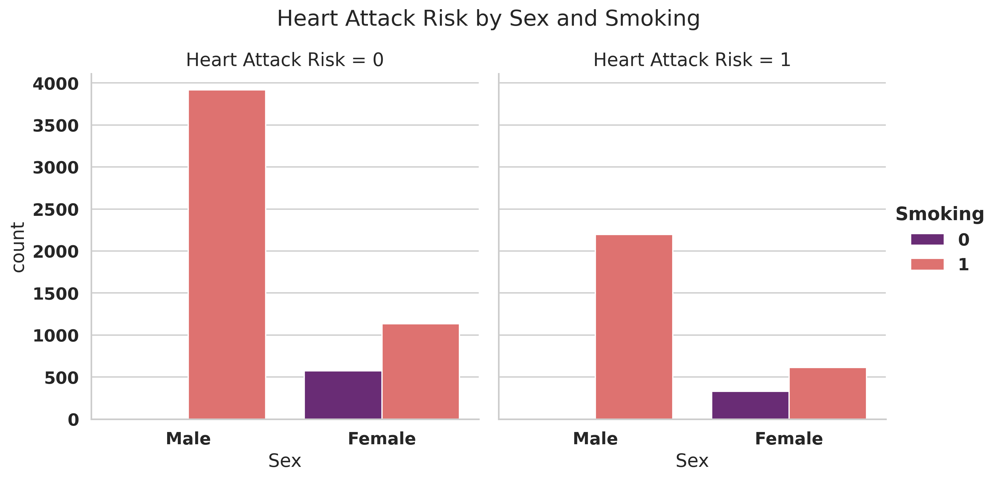

In [26]:
sns.catplot(data=df, x='Sex', hue='Smoking', col='Heart Attack Risk', kind='count', palette='magma')
plt.suptitle("Heart Attack Risk by Sex and Smoking", y=1.05)
plt.show()


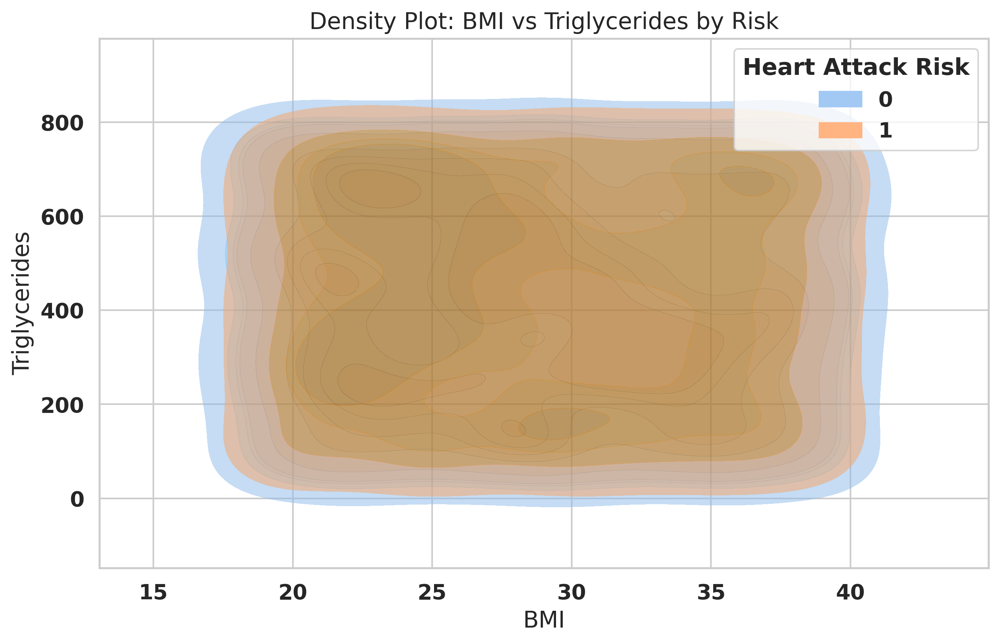

In [27]:
sns.kdeplot(data=df, x='BMI', y='Triglycerides', hue='Heart Attack Risk', cmap="RdBu", fill=True, alpha=0.5)
plt.title("Density Plot: BMI vs Triglycerides by Risk")
plt.show()


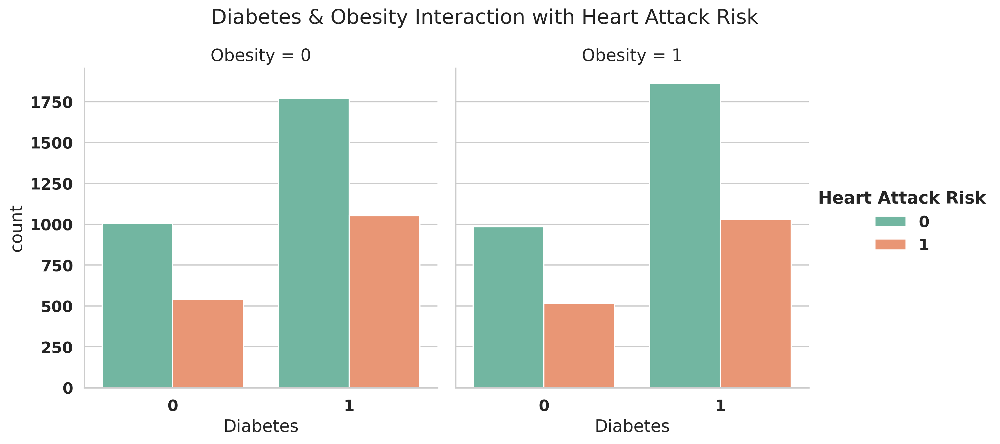

In [28]:
diabetes_obesity = df.groupby(['Diabetes', 'Obesity', 'Heart Attack Risk']).size().reset_index(name='count')
g = sns.catplot(data=diabetes_obesity, kind='bar', x='Diabetes', y='count', hue='Heart Attack Risk', col='Obesity', palette='Set2')
g.fig.suptitle("Diabetes & Obesity Interaction with Heart Attack Risk", y=1.05)
plt.show()


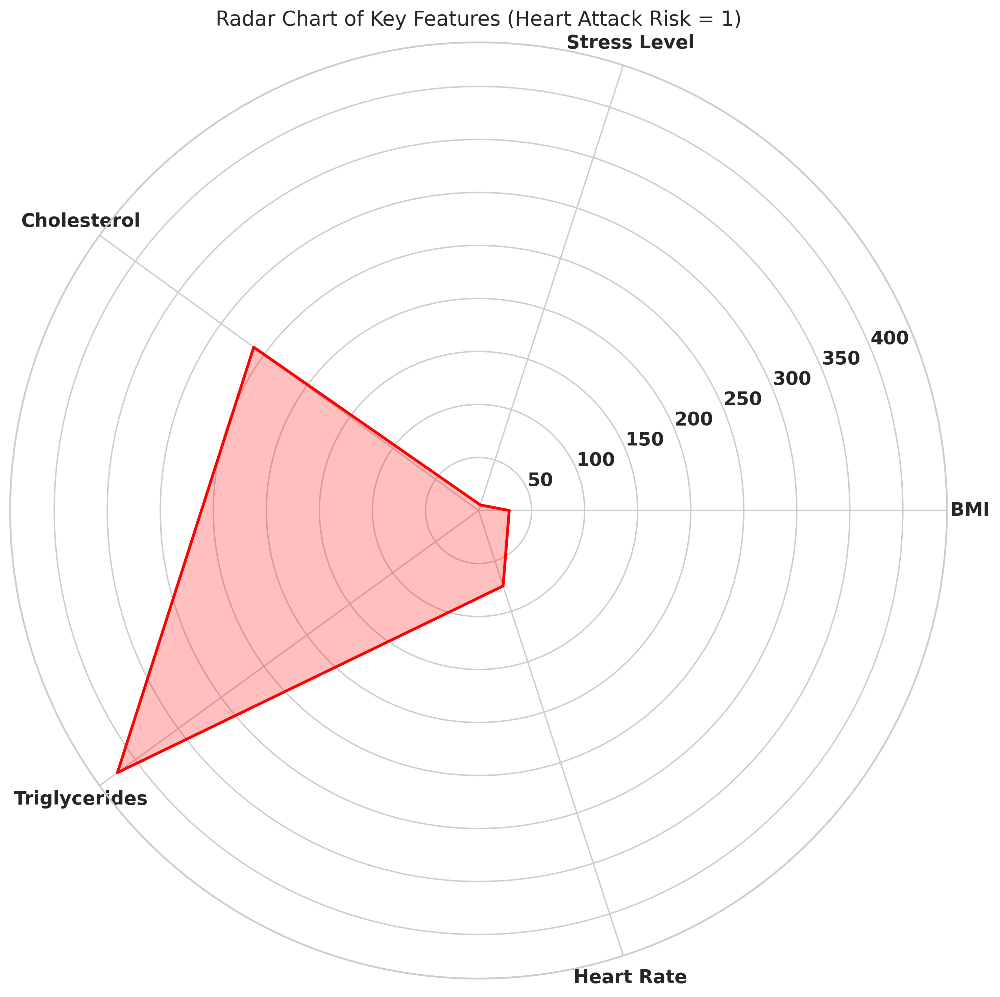

In [32]:
import numpy as np

features = ['BMI', 'Stress Level', 'Cholesterol', 'Triglycerides', 'Heart Rate']
means_risk1 = df[df['Heart Attack Risk'] == 1][features].mean()

angles = np.linspace(0, 2 * np.pi, len(features), endpoint=False).tolist()
stats = means_risk1.tolist()
stats += stats[:1]
angles += angles[:1]

fig, ax = plt.subplots(figsize=(12, 12), subplot_kw=dict(polar=True))
ax.plot(angles, stats, color='red', linewidth=2)
ax.fill(angles, stats, color='red', alpha=0.25)
ax.set_xticks(angles[:-1])
ax.set_xticklabels(features)
plt.title("Radar Chart of Key Features (Heart Attack Risk = 1)")
plt.show()


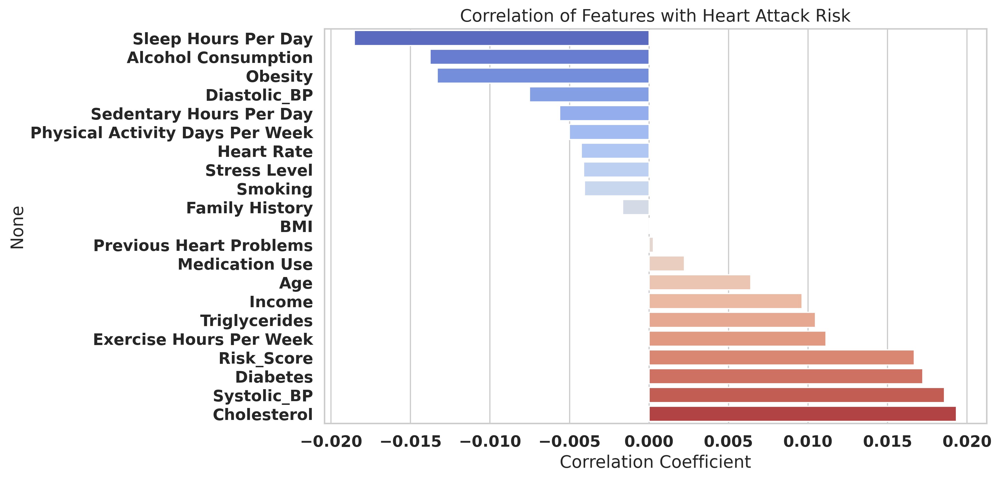

In [31]:
numeric_features = df.select_dtypes(include='number').drop(columns=['Heart Attack Risk'])
corr = numeric_features.corrwith(df['Heart Attack Risk']).sort_values()

sns.barplot(x=corr.values, y=corr.index, palette='coolwarm')
plt.title("Correlation of Features with Heart Attack Risk")
plt.xlabel("Correlation Coefficient")
plt.show()


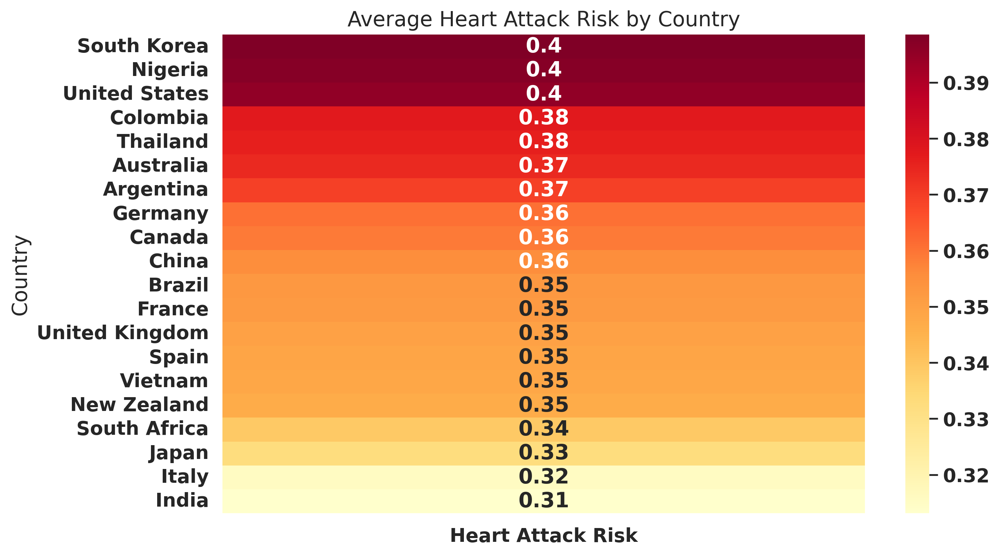

In [33]:
country_pivot = df.pivot_table(index='Country', values='Heart Attack Risk', aggfunc='mean').sort_values(by='Heart Attack Risk', ascending=False)
sns.heatmap(country_pivot, cmap='YlOrRd', annot=True)
plt.title("Average Heart Attack Risk by Country")
plt.show()


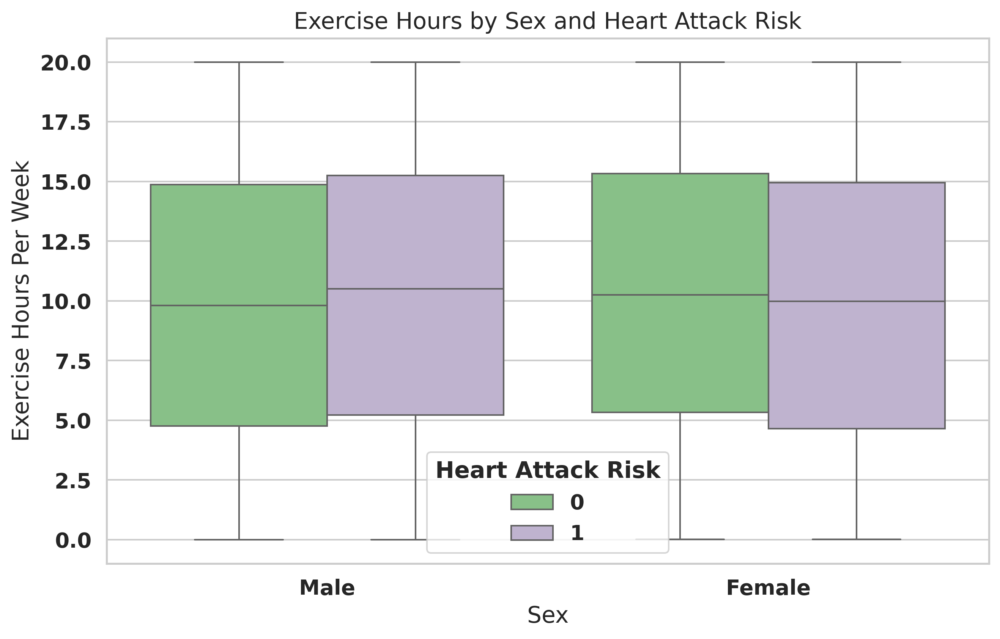

In [34]:
sns.boxplot(data=df, x='Sex', y='Exercise Hours Per Week', hue='Heart Attack Risk', palette='Accent')
plt.title("Exercise Hours by Sex and Heart Attack Risk")
plt.show()


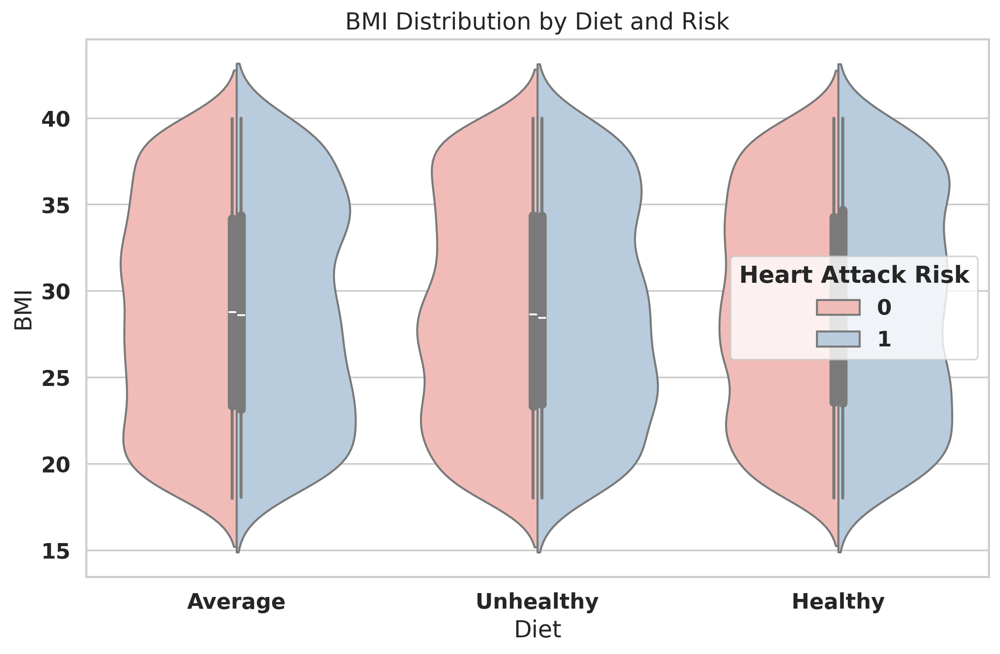

In [35]:
sns.violinplot(data=df, x='Diet', y='BMI', hue='Heart Attack Risk', split=True, palette='Pastel1')
plt.title("BMI Distribution by Diet and Risk")
plt.show()


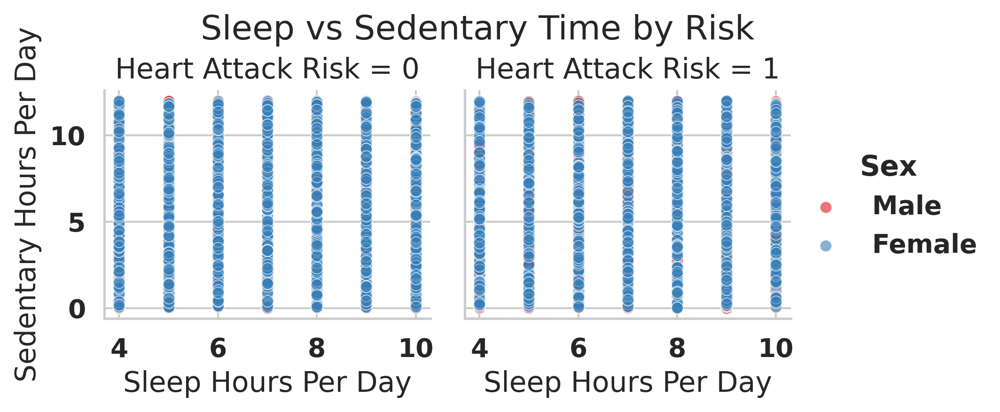

In [36]:
g = sns.FacetGrid(df, col='Heart Attack Risk', hue='Sex', palette='Set1')
g.map_dataframe(sns.scatterplot, x='Sleep Hours Per Day', y='Sedentary Hours Per Day', alpha=0.6)
g.add_legend()
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle("Sleep vs Sedentary Time by Risk")
plt.show()


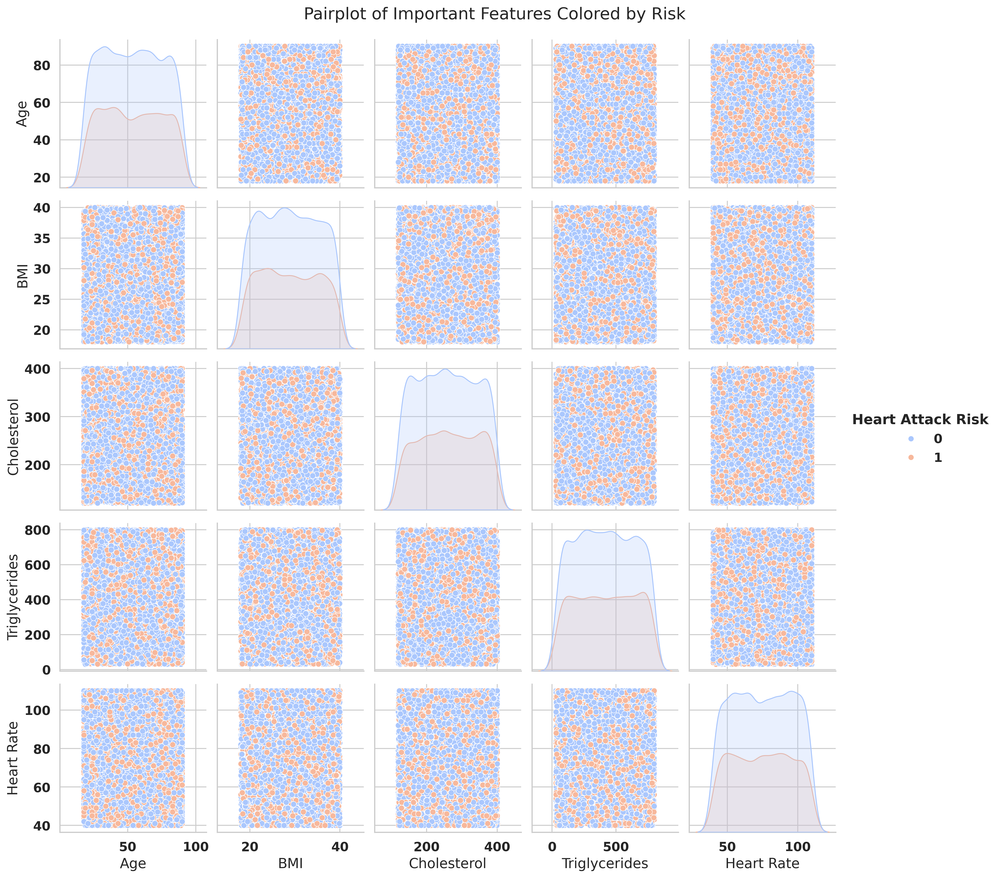

In [37]:
important_features = ['Age', 'BMI', 'Cholesterol', 'Triglycerides', 'Heart Rate', 'Heart Attack Risk']
sns.pairplot(df[important_features], hue='Heart Attack Risk', palette='coolwarm')
plt.suptitle("Pairplot of Important Features Colored by Risk", y=1.02)
plt.show()


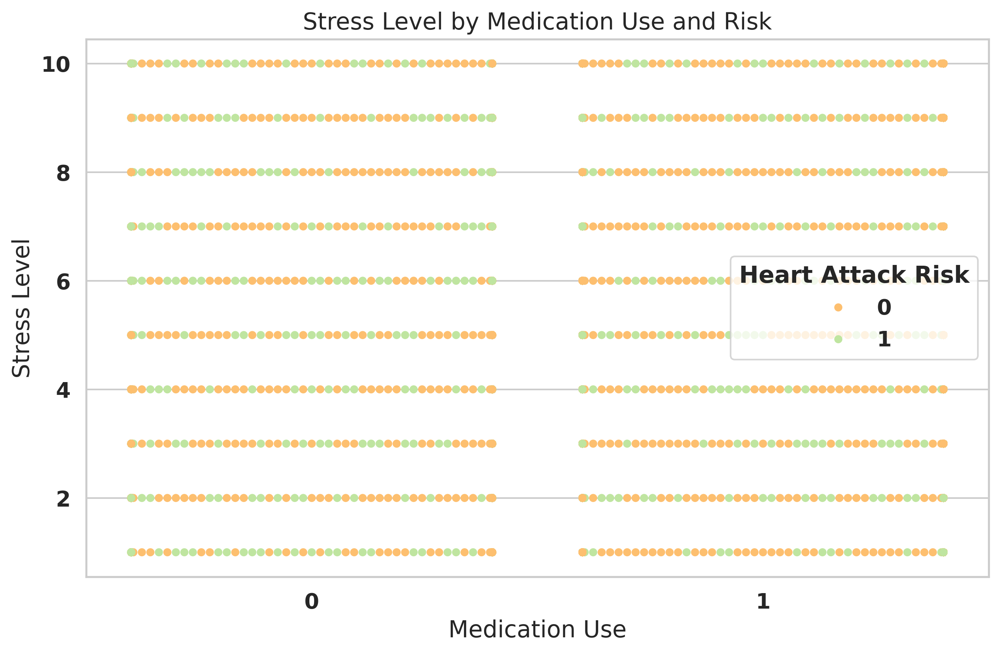

In [38]:
sns.swarmplot(data=df, x='Medication Use', y='Stress Level', hue='Heart Attack Risk', palette='Spectral')
plt.title("Stress Level by Medication Use and Risk")
plt.show()


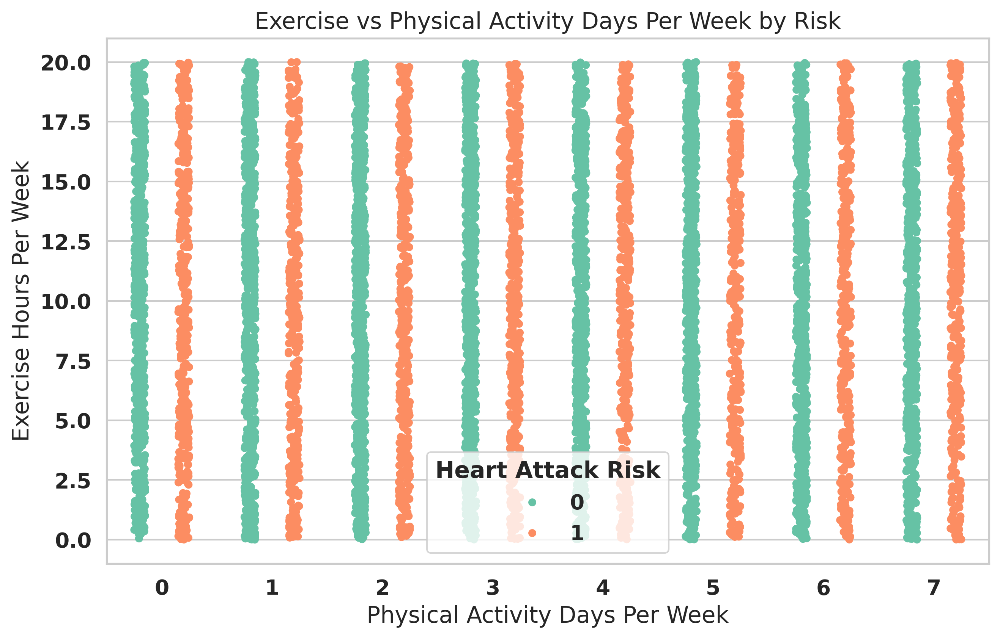

In [39]:
sns.stripplot(data=df, x='Physical Activity Days Per Week', y='Exercise Hours Per Week', hue='Heart Attack Risk', dodge=True, jitter=True, palette='Set2')
plt.title("Exercise vs Physical Activity Days Per Week by Risk")
plt.show()


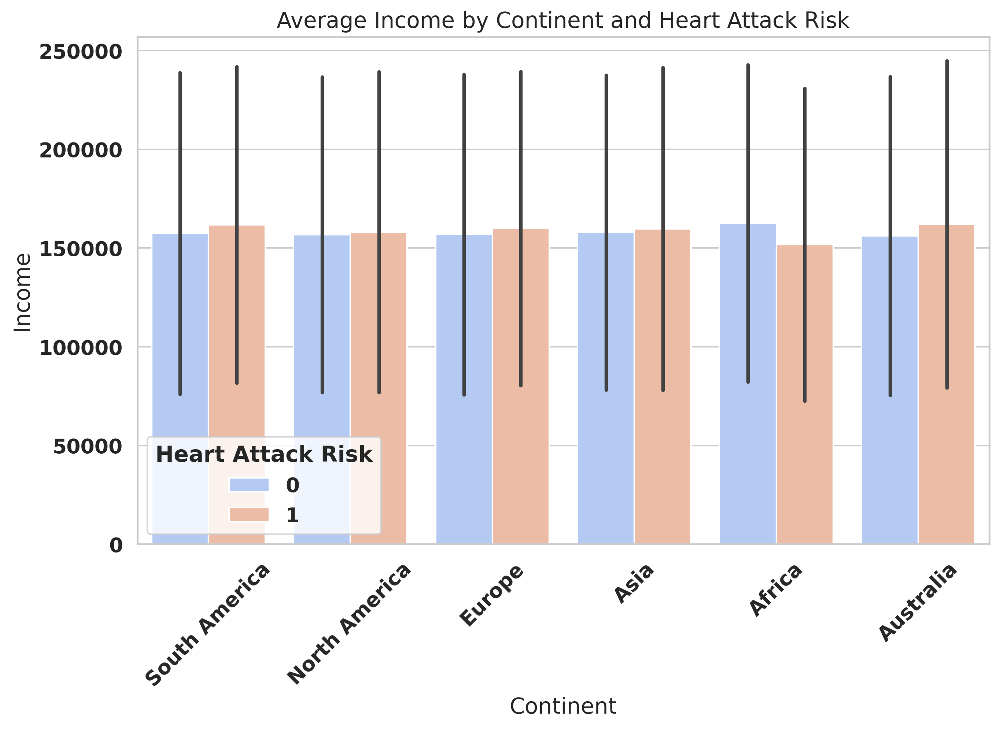

In [40]:
sns.barplot(data=df, x='Continent', y='Income', hue='Heart Attack Risk', ci='sd', palette='coolwarm')
plt.title("Average Income by Continent and Heart Attack Risk")
plt.xticks(rotation=45)
plt.show()


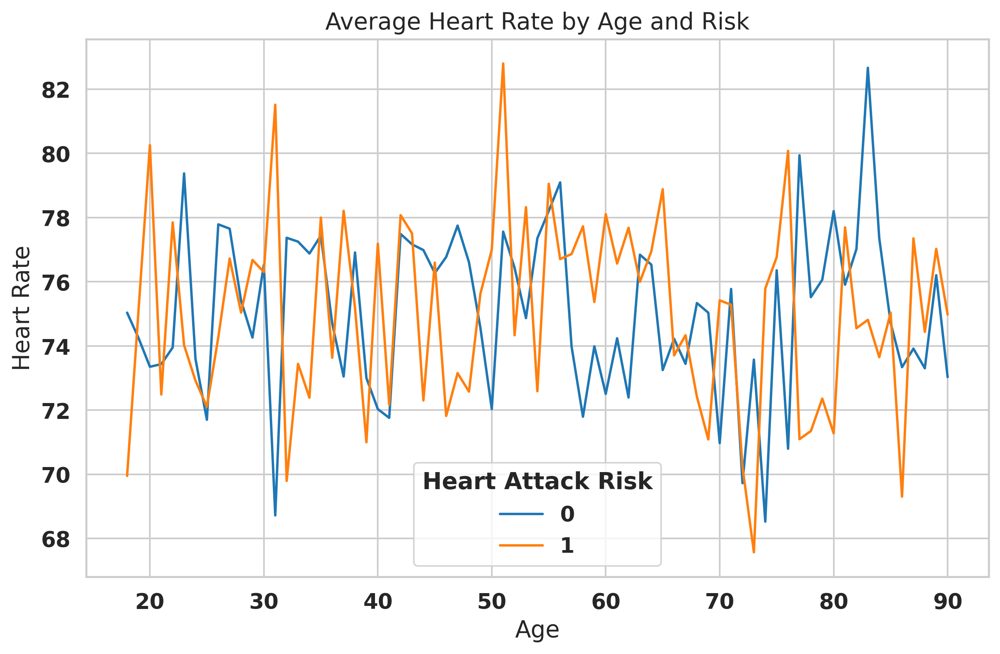

In [41]:
line_data = df.groupby(['Age', 'Heart Attack Risk'])['Heart Rate'].mean().reset_index()
sns.lineplot(data=line_data, x='Age', y='Heart Rate', hue='Heart Attack Risk', palette='tab10')
plt.title("Average Heart Rate by Age and Risk")
plt.show()


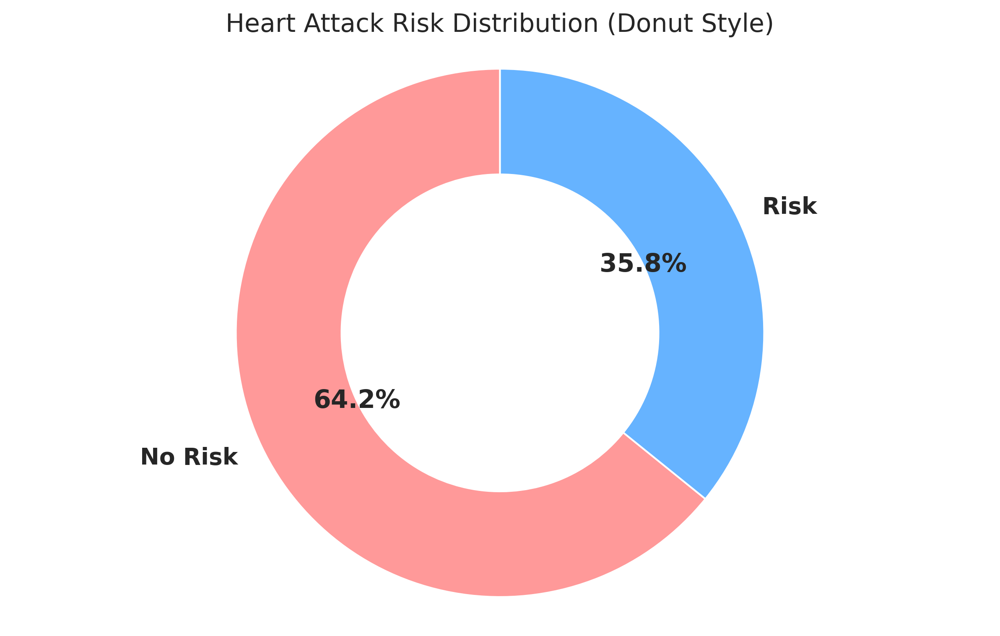

In [42]:
risk_counts = df['Heart Attack Risk'].value_counts()
colors = ['#ff9999','#66b3ff']
plt.pie(risk_counts, labels=['No Risk', 'Risk'], autopct='%1.1f%%', startangle=90, colors=colors, wedgeprops={'width':0.4})
plt.title("Heart Attack Risk Distribution (Donut Style)")
plt.axis('equal')
plt.show()


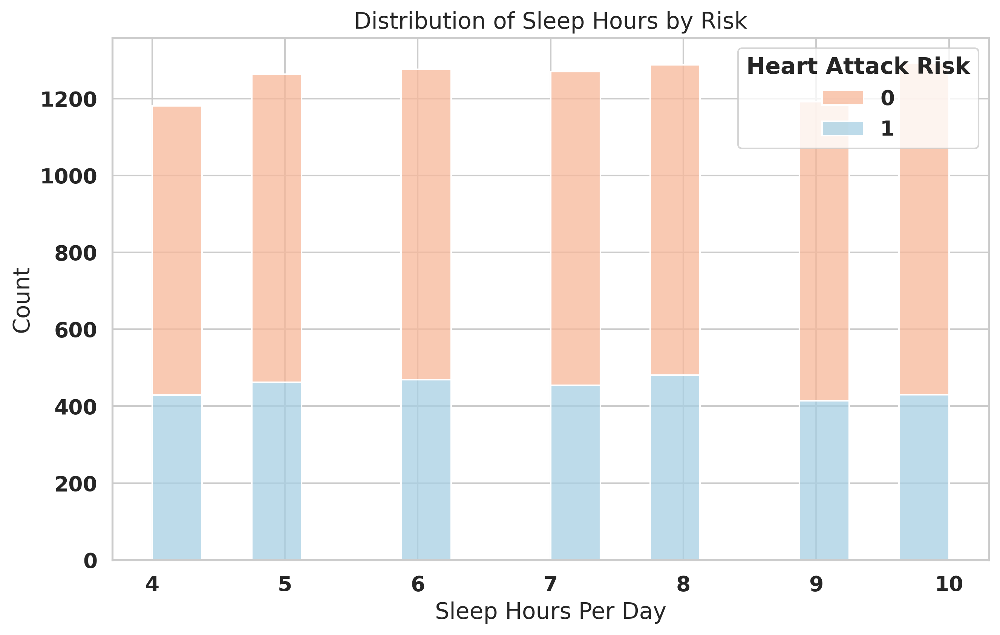

In [43]:
sns.histplot(data=df, x='Sleep Hours Per Day', hue='Heart Attack Risk', multiple='stack', palette='RdBu')
plt.title("Distribution of Sleep Hours by Risk")
plt.show()


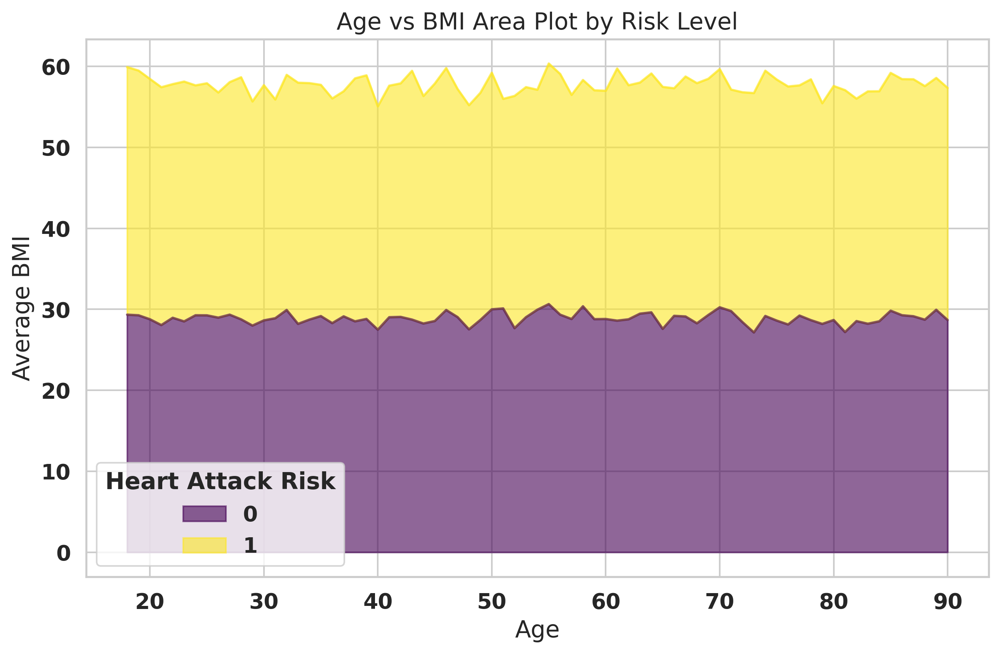

In [44]:
age_bmi = df.groupby(['Age', 'Heart Attack Risk'])['BMI'].mean().unstack().fillna(0)
age_bmi.plot.area(colormap='viridis', alpha=0.6)
plt.title("Age vs BMI Area Plot by Risk Level")
plt.ylabel("Average BMI")
plt.xlabel("Age")
plt.show()


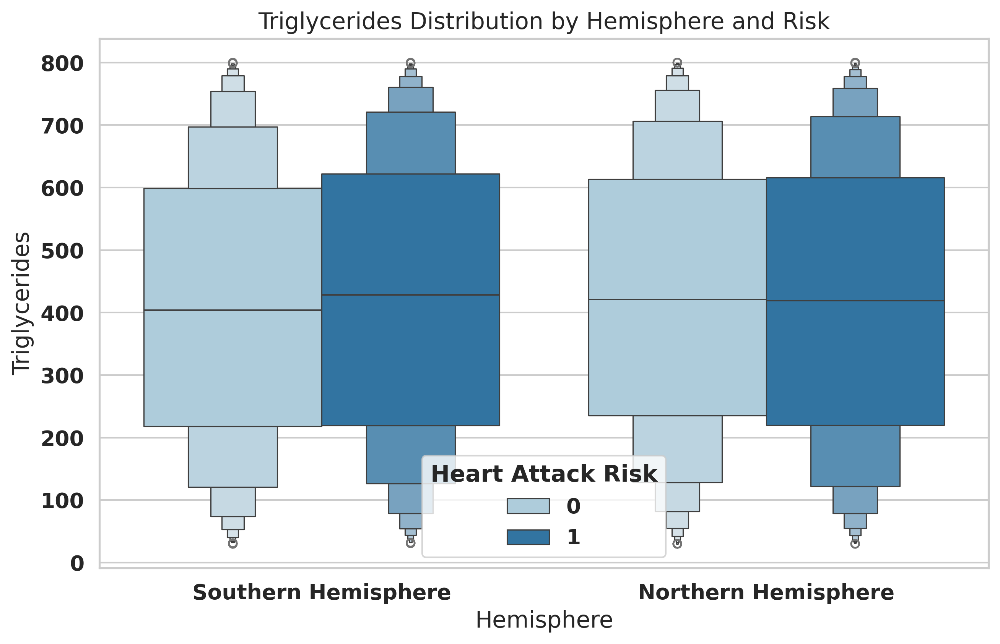

In [45]:
sns.boxenplot(data=df, x='Hemisphere', y='Triglycerides', hue='Heart Attack Risk', palette='Paired')
plt.title("Triglycerides Distribution by Hemisphere and Risk")
plt.show()


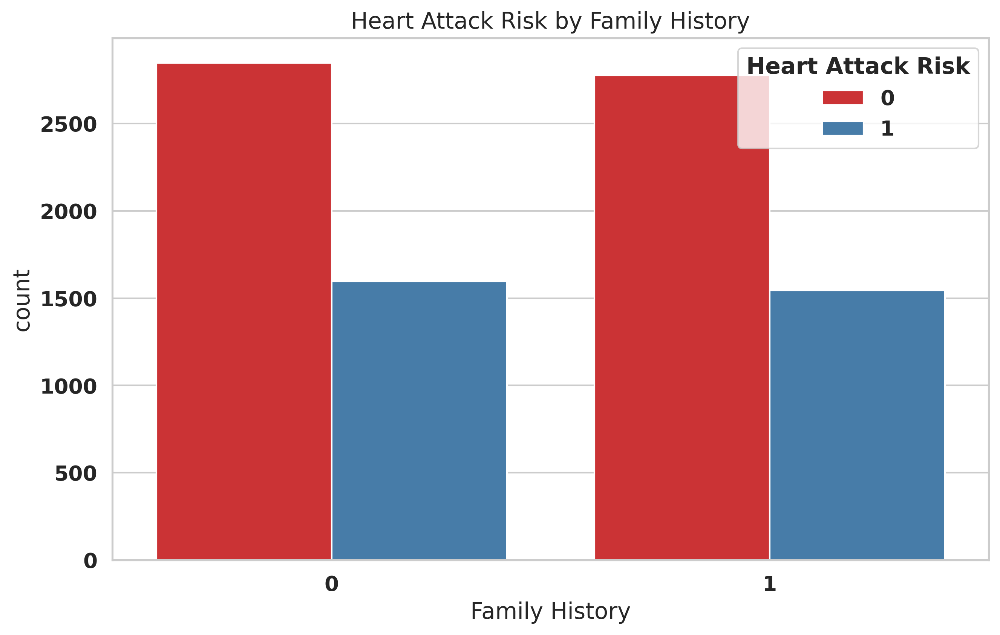

In [46]:
sns.countplot(data=df, x='Family History', hue='Heart Attack Risk', palette='Set1')
plt.title("Heart Attack Risk by Family History")
plt.show()


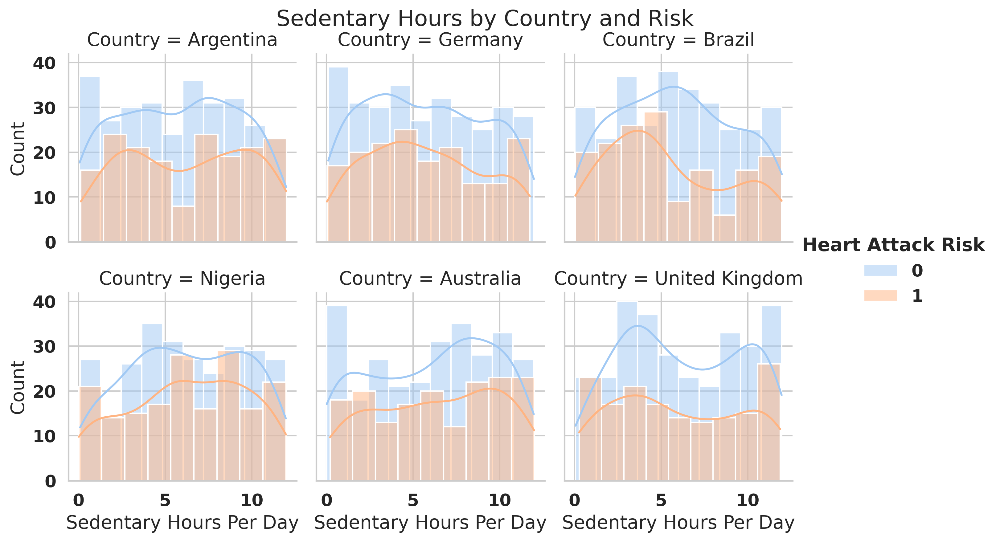

In [47]:
top_countries = df['Country'].value_counts().head(6).index.tolist()
subset_df = df[df['Country'].isin(top_countries)]

g = sns.FacetGrid(subset_df, col='Country', hue='Heart Attack Risk', col_wrap=3)
g.map_dataframe(sns.histplot, x='Sedentary Hours Per Day', kde=True, multiple='stack')
g.add_legend()
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Sedentary Hours by Country and Risk")
plt.show()


In [48]:
df.drop_duplicates(inplace=True)

# Split Blood Pressure into Systolic & Diastolic
df[['Systolic_BP', 'Diastolic_BP']] = df['Blood Pressure'].str.split('/', expand=True).astype(int)
df.drop(columns=['Blood Pressure'], inplace=True)

# Handle missing values (if any)
df.fillna({
    'Exercise Hours Per Week': df['Exercise Hours Per Week'].median(),
    'Diet': df['Diet'].mode()[0],
    'Income': df['Income'].median()
}, inplace=True)

# Convert categorical columns
categorical_cols = ['Sex', 'Country', 'Continent', 'Hemisphere', 'Diet']
df[categorical_cols] = df[categorical_cols].astype('category')

# Encode binary columns
binary_cols = ['Diabetes', 'Family History', 'Smoking', 'Obesity', 'Alcohol Consumption',
               'Previous Heart Problems', 'Medication Use']
df[binary_cols] = df[binary_cols].astype(int)

# Encode 'Sex'
df['Sex'] = df['Sex'].map({'Male': 1, 'Female': 0})

# Optional: Label encode high-cardinality features
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df['Country'] = le.fit_transform(df['Country'])

# Reorder columns: move target to end
target = 'Heart Attack Risk'
df = df[[col for col in df.columns if col != target] + [target]]

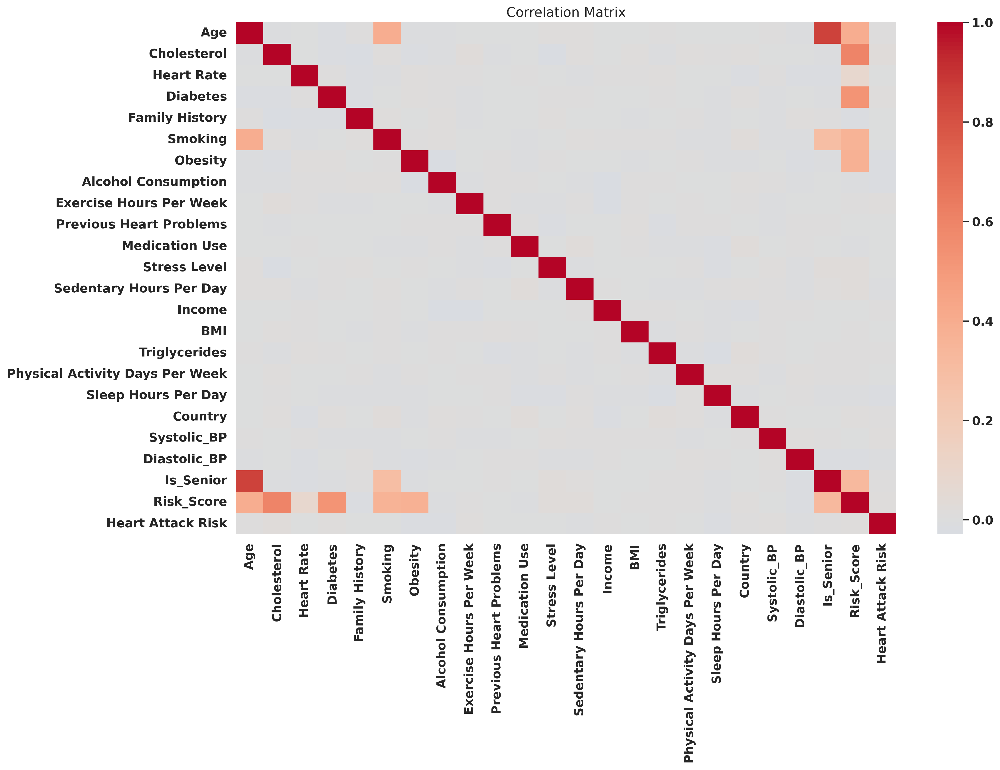

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(16, 10))
corr = df.corr(numeric_only=True)
sns.heatmap(corr, annot=False, cmap='coolwarm', center=0)
plt.title("Correlation Matrix")
plt.show()


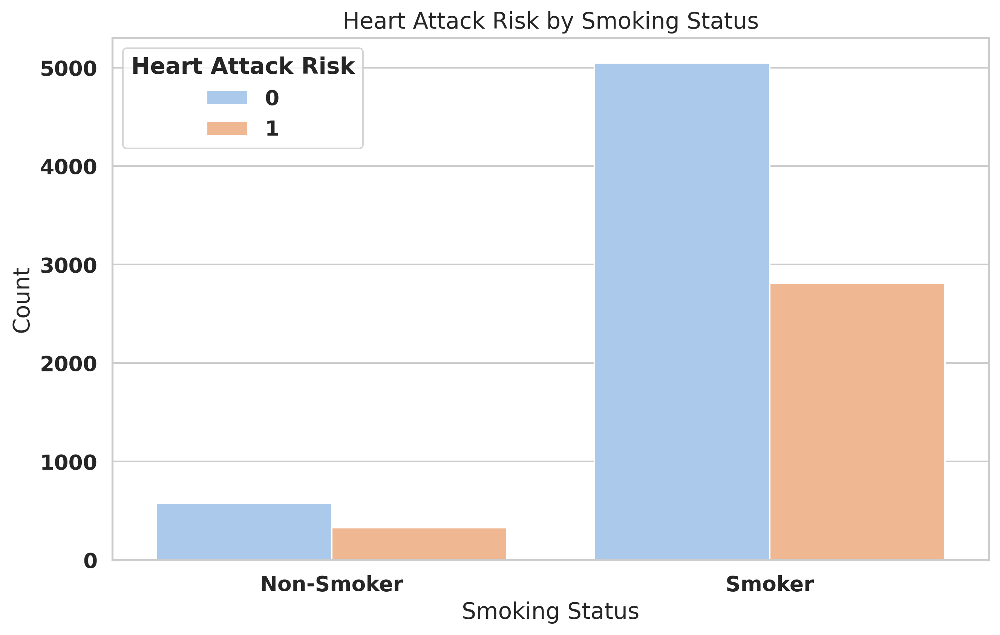

In [50]:
sns.countplot(x='Smoking', hue='Heart Attack Risk', data=df, palette='pastel')
plt.title("Heart Attack Risk by Smoking Status")
plt.xticks([0, 1], ['Non-Smoker', 'Smoker'])
plt.xlabel("Smoking Status")
plt.ylabel("Count")
plt.show()


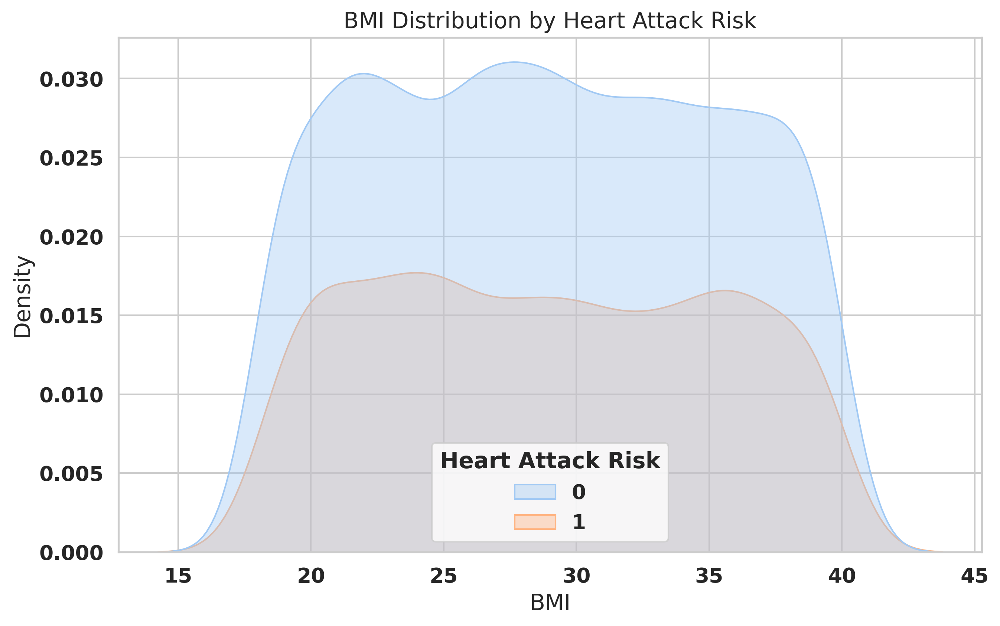

In [51]:
sns.kdeplot(data=df, x='BMI', hue='Heart Attack Risk', fill=True, alpha=0.4)
plt.title("BMI Distribution by Heart Attack Risk")
plt.show()


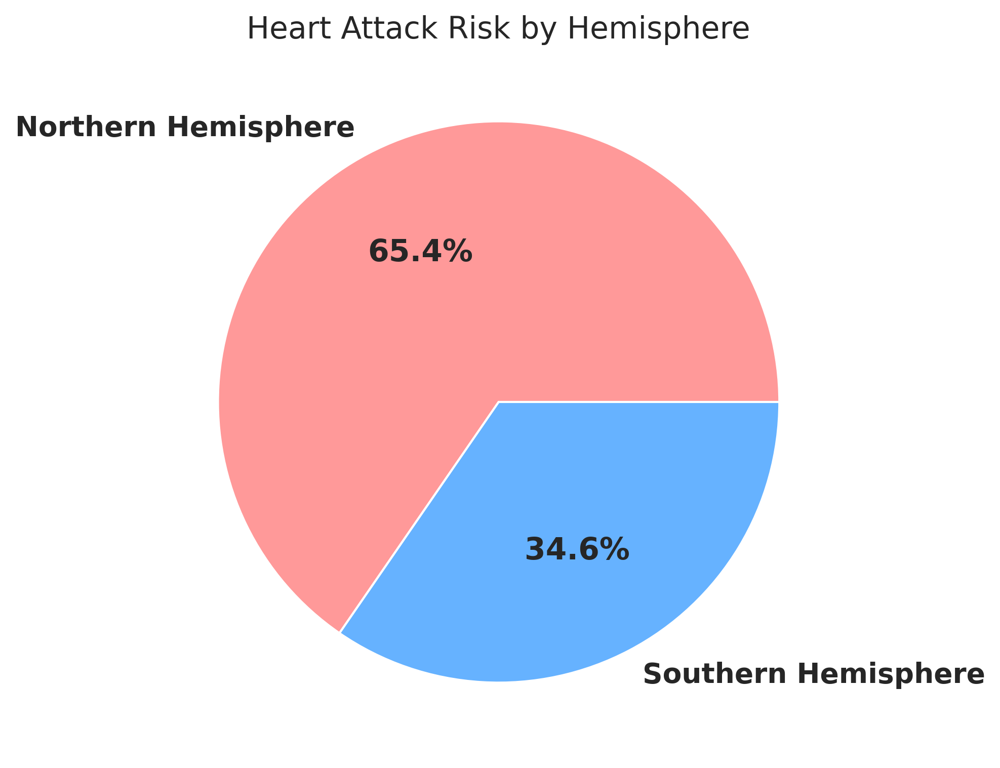

In [52]:
hemisphere_counts = df[df['Heart Attack Risk'] == 1]['Hemisphere'].value_counts()
plt.figure(figsize=(6,6))
plt.pie(hemisphere_counts, labels=hemisphere_counts.index, autopct='%1.1f%%', colors=['#FF9999','#66B2FF'])
plt.title("Heart Attack Risk by Hemisphere")
plt.show()


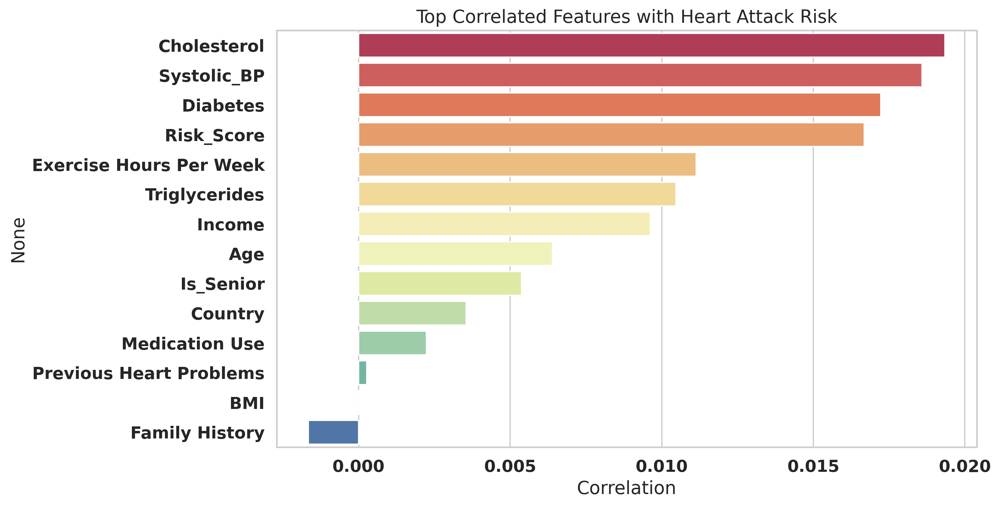

In [53]:
import numpy as np

# Calculate correlation with Heart Attack Risk
target_corr = df.corr(numeric_only=True)['Heart Attack Risk'].sort_values(ascending=False)[1:15]
sns.barplot(x=target_corr.values, y=target_corr.index, palette='Spectral')
plt.title("Top Correlated Features with Heart Attack Risk")
plt.xlabel("Correlation")
plt.show()


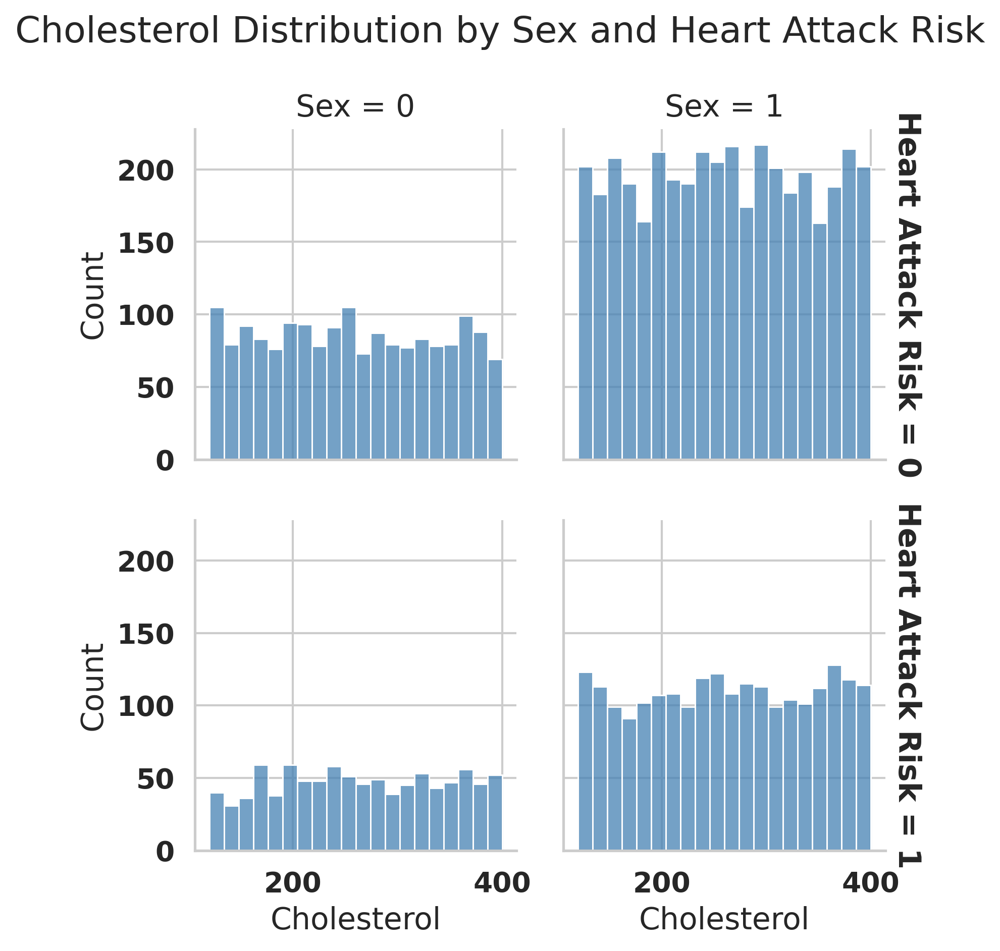

In [54]:
g = sns.FacetGrid(df, col="Sex", row="Heart Attack Risk", margin_titles=True)
g.map(sns.histplot, "Cholesterol", bins=20, color="steelblue")
g.fig.suptitle("Cholesterol Distribution by Sex and Heart Attack Risk", y=1.05)
plt.show()


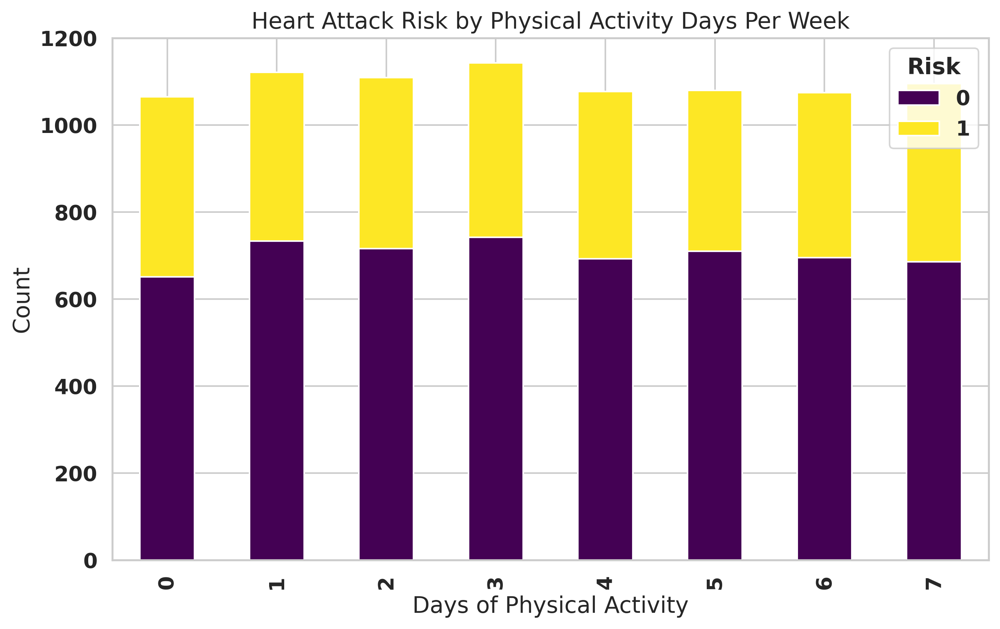

In [56]:
activity_risk = pd.crosstab(df['Physical Activity Days Per Week'], df['Heart Attack Risk'])
activity_risk.plot(kind='bar', stacked=True, colormap='viridis')
plt.title("Heart Attack Risk by Physical Activity Days Per Week")
plt.xlabel("Days of Physical Activity")
plt.ylabel("Count")
plt.legend(title='Risk')
plt.show()


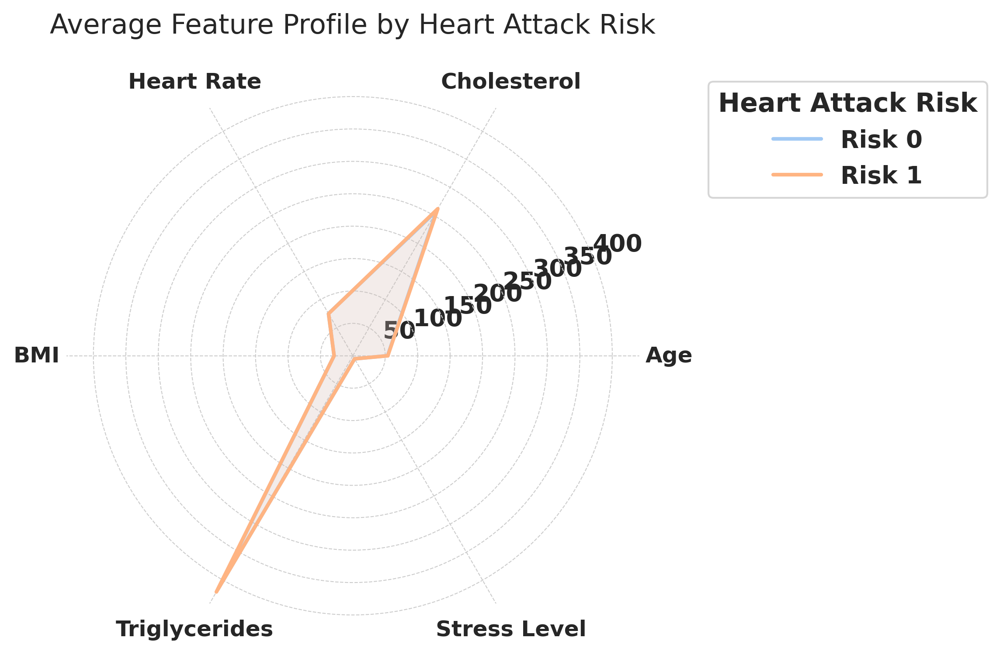

In [58]:
import numpy as np
import matplotlib.pyplot as plt

# Define features
features = ['Age', 'Cholesterol', 'Heart Rate', 'BMI', 'Triglycerides', 'Stress Level']
grouped = df.groupby('Heart Attack Risk')[features].mean()

# Prepare angles and labels
labels = np.array(features)
angles = np.linspace(0, 2 * np.pi, len(labels), endpoint=False).tolist()
angles += angles[:1]  # Close the circle

# Initialize plot
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

# Plot each group
for i, row in grouped.iterrows():
    values = row.tolist()
    values += values[:1]  # Close the polygon
    ax.plot(angles, values, label=f'Risk {i}', linewidth=2)
    ax.fill(angles, values, alpha=0.15)

# Set the axis
ax.set_thetagrids(np.degrees(angles[:-1]), labels, fontsize=12)
ax.set_title("Average Feature Profile by Heart Attack Risk", fontsize=15, pad=20)

# Customize grid and style
ax.grid(True, linestyle='--', linewidth=0.5)
ax.spines['polar'].set_visible(False)

# Place legend outside the plot
plt.legend(loc='upper left', bbox_to_anchor=(1.1, 1.0), title="Heart Attack Risk")

plt.tight_layout()
plt.show()


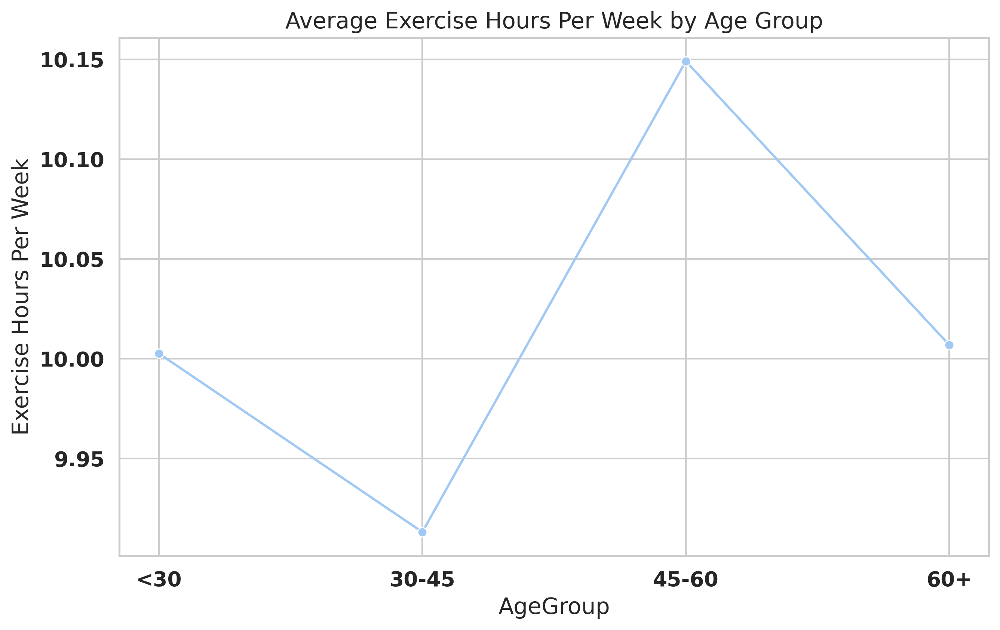

In [61]:
df['AgeGroup'] = pd.cut(df['Age'], bins=[0, 30, 45, 60, 100], labels=['<30', '30-45', '45-60', '60+'])
age_group_exercise = df.groupby('AgeGroup')['Exercise Hours Per Week'].mean().reset_index()

sns.lineplot(data=age_group_exercise, x='AgeGroup', y='Exercise Hours Per Week', marker='o')
plt.title("Average Exercise Hours Per Week by Age Group")
plt.show()


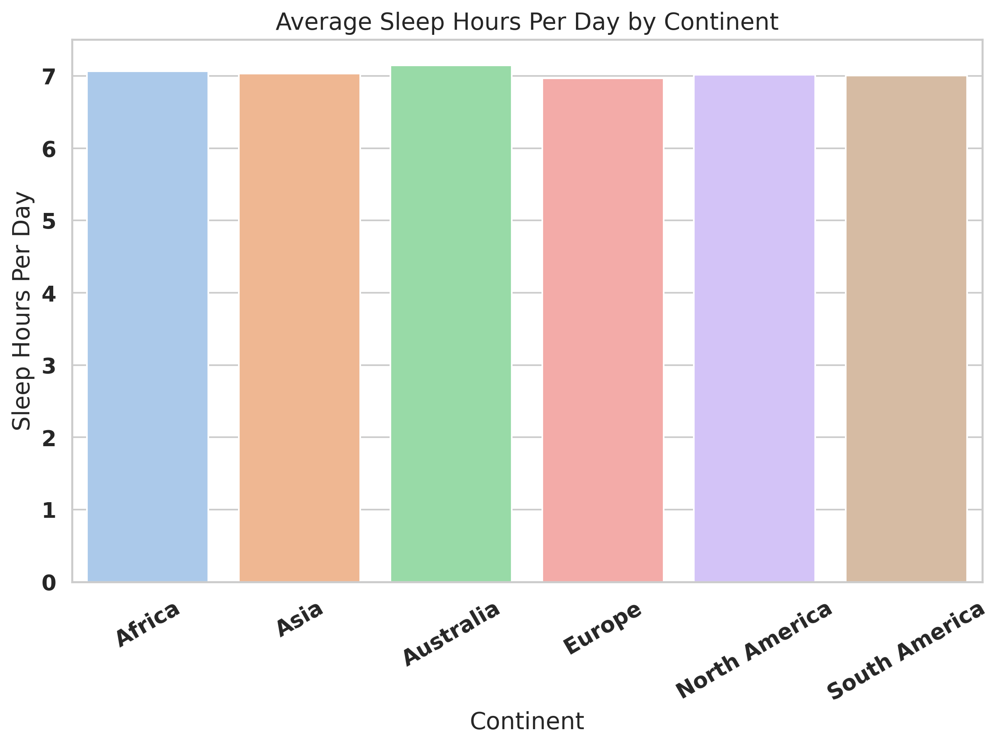

In [62]:
continent_sleep = df.groupby('Continent')['Sleep Hours Per Day'].mean().sort_values()
sns.barplot(x=continent_sleep.index, y=continent_sleep.values, palette='pastel')
plt.title("Average Sleep Hours Per Day by Continent")
plt.xticks(rotation=30)
plt.ylabel("Sleep Hours Per Day")
plt.show()


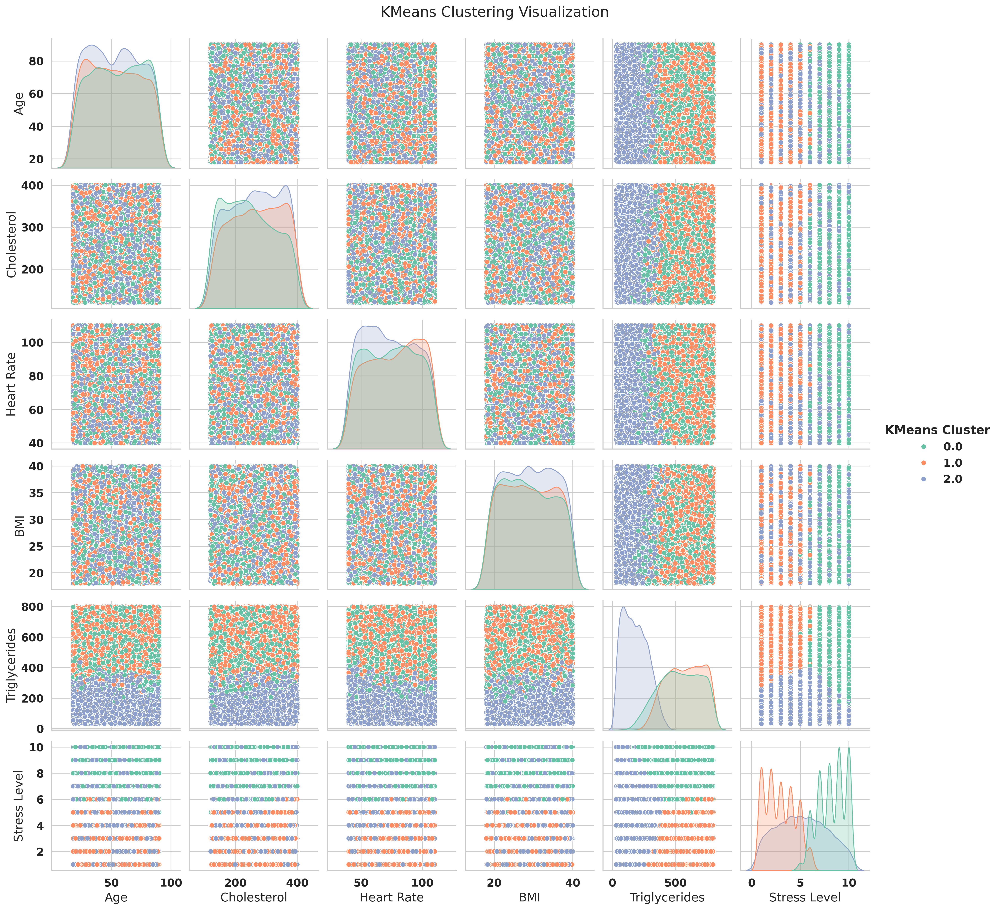

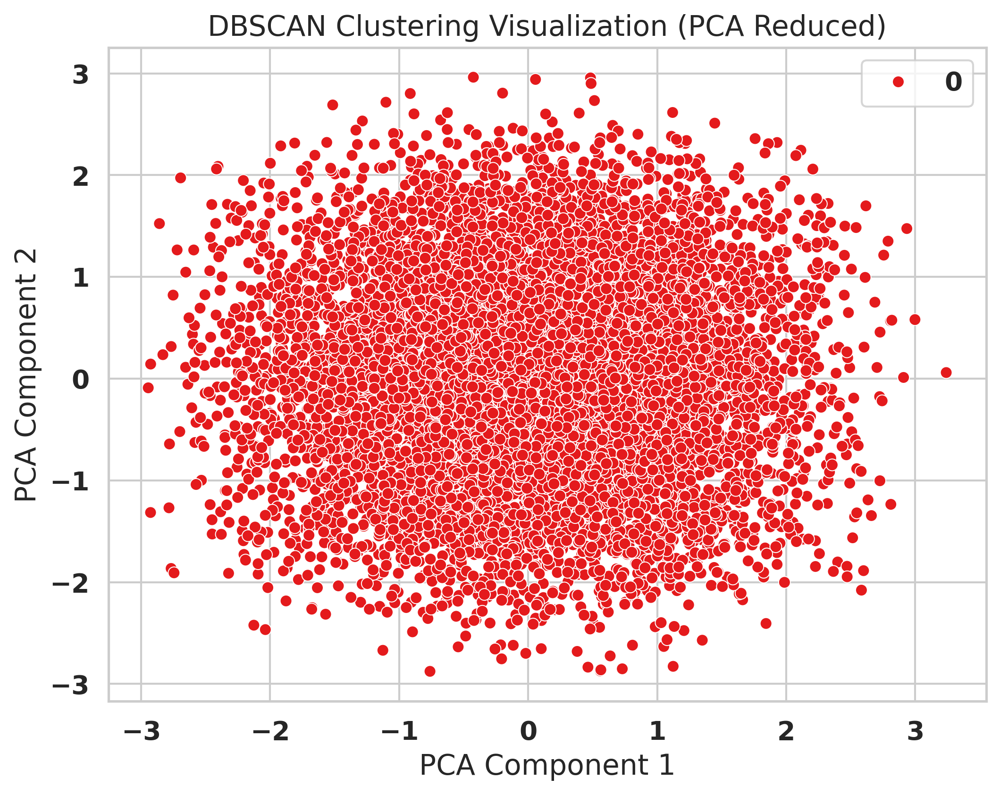

In [66]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Select numeric features for clustering
features = ['Age', 'Cholesterol', 'Heart Rate', 'BMI', 'Triglycerides', 'Stress Level']

X = df[features].dropna()
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# KMeans Clustering
kmeans = KMeans(n_clusters=3, random_state=42)
clusters_kmeans = kmeans.fit_predict(X_scaled)

# DBSCAN Clustering
dbscan = DBSCAN(eps=1.2, min_samples=10)
clusters_dbscan = dbscan.fit_predict(X_scaled)

# Add cluster labels to the dataframe
df.loc[X.index, 'KMeans Cluster'] = clusters_kmeans
df.loc[X.index, 'DBSCAN Cluster'] = clusters_dbscan

# Visualize clusters with pairplot for KMeans
sns.pairplot(df.loc[X.index], vars=features, hue='KMeans Cluster', palette='Set2', diag_kind='kde')
plt.suptitle("KMeans Clustering Visualization", y=1.02)
plt.show()

# Visualize clusters with PCA 2D plot for DBSCAN
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

plt.figure(figsize=(8,6))
sns.scatterplot(x=X_pca[:,0], y=X_pca[:,1], hue=clusters_dbscan, palette='Set1', legend='full')
plt.title("DBSCAN Clustering Visualization (PCA Reduced)")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.show()



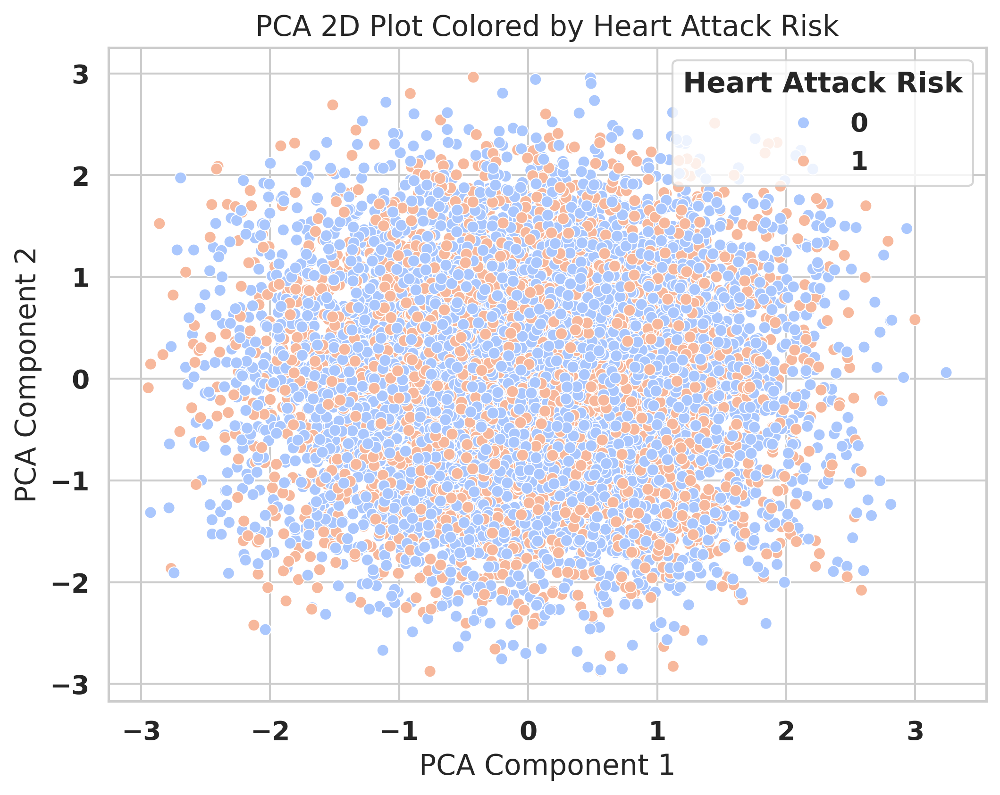

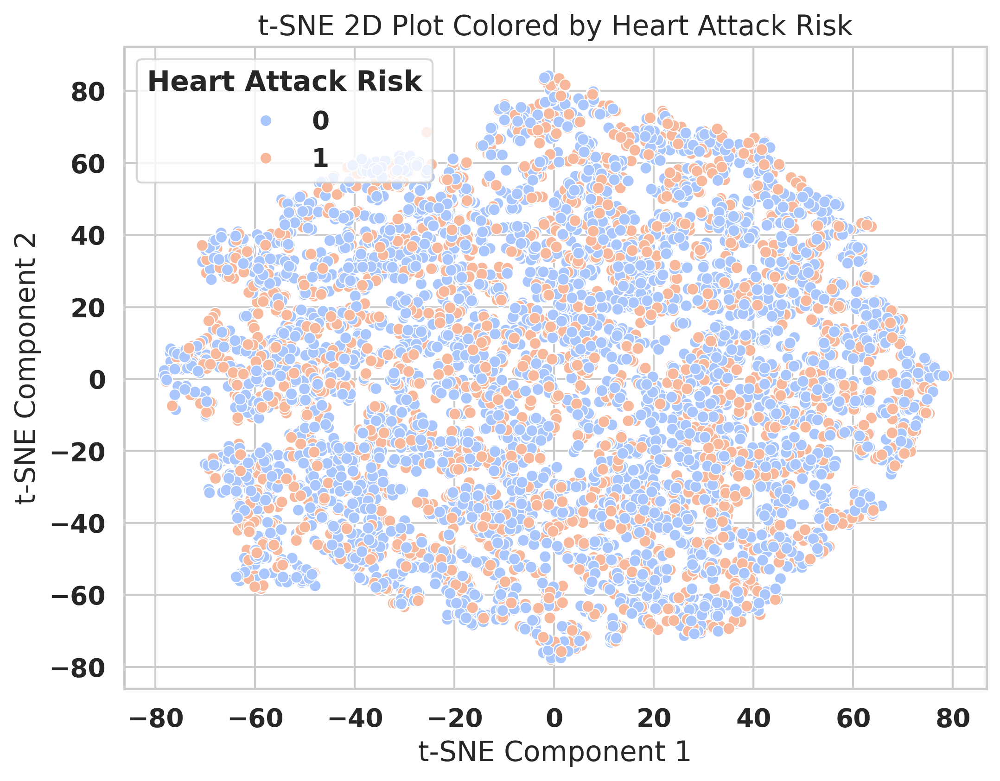

In [67]:
from sklearn.manifold import TSNE

# PCA 2D plot colored by Heart Attack Risk
plt.figure(figsize=(8,6))
sns.scatterplot(x=X_pca[:,0], y=X_pca[:,1], hue=df.loc[X.index, 'Heart Attack Risk'], palette='coolwarm')
plt.title("PCA 2D Plot Colored by Heart Attack Risk")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.show()

# t-SNE 2D embedding
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000)
X_tsne = tsne.fit_transform(X_scaled)

plt.figure(figsize=(8,6))
sns.scatterplot(x=X_tsne[:,0], y=X_tsne[:,1], hue=df.loc[X.index, 'Heart Attack Risk'], palette='coolwarm')
plt.title("t-SNE 2D Plot Colored by Heart Attack Risk")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.show()


In [69]:
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 992.3/992.3 kB 12.5 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 61.5 MB/s eta 0:00:00:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.4/42.4 MB 22.5 MB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 23.0.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


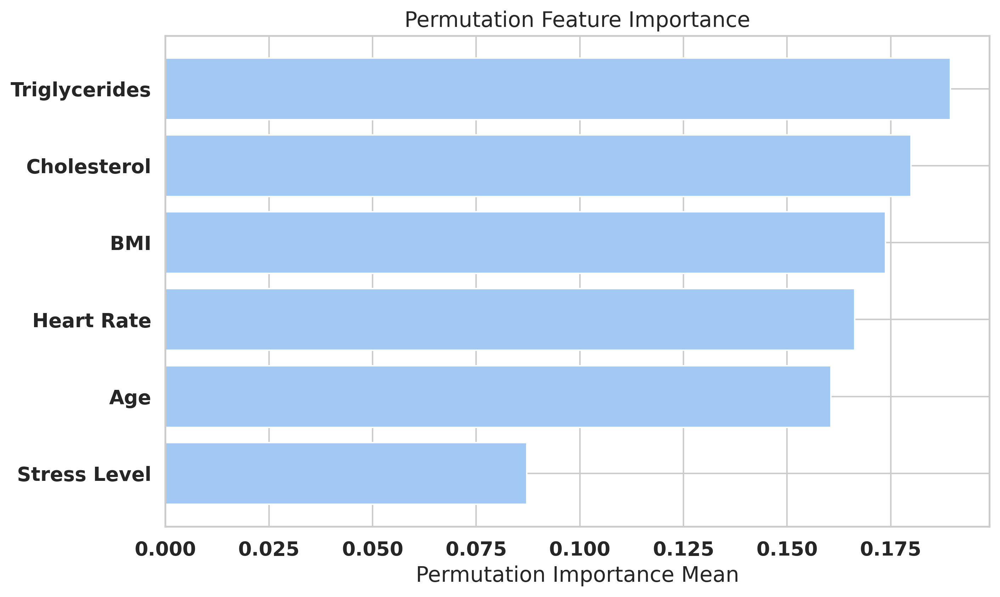

In [71]:
from sklearn.inspection import permutation_importance

result = permutation_importance(rf, X, y, n_repeats=10, random_state=42, n_jobs=-1)

perm_sorted_idx = result.importances_mean.argsort()[::-1]
plt.figure(figsize=(10,6))
plt.barh(range(len(perm_sorted_idx)), result.importances_mean[perm_sorted_idx])
plt.yticks(range(len(perm_sorted_idx)), np.array(features)[perm_sorted_idx])
plt.xlabel("Permutation Importance Mean")
plt.title("Permutation Feature Importance")
plt.gca().invert_yaxis()
plt.show()
